In [1]:
from LDA_search_and_visualize import *

# GERMAN CREDIT

In [2]:
# Data wrangling

attribute_list=[
    'checking_account_category'
    ,'duration_in_month'
    ,'credit_history_category'
    ,'purpose_category'
    ,'credit_amount'
    ,'savings_account_category'
    ,'unemployment_category'
    ,'installment_rate_percentage_income'
    ,'sex_and_marriage_status_category'
    ,'other_debtors_guarantors_category'
    ,'present_residence_duration'
    ,'property_category'
    ,'age'
    ,'installment_plans_category'
    ,'housing_category'
    ,'number_existing_credits_at_bank'
    ,'job_category'
    ,'number_of_people_liable_maintenance'
    ,'telephone_category'
    ,'foreign_category'
    ,'y'
]
german = pd.read_csv('~/Python Projects/LDA_empirics/statlog+german+credit+data 2/german.data'
                     ,names=attribute_list
                     ,index_col=False
                     ,delimiter=' '
                     #,header=0
                    )
german['y']=german['y']-1
german['sex_category']=np.logical_not(np.logical_or(np.equal(german['sex_and_marriage_status_category'],'A92'), np.equal(german['sex_and_marriage_status_category'],'A95')))
german['single_category']=np.logical_or(np.equal(german['sex_and_marriage_status_category'],'A93'), np.equal(german['sex_and_marriage_status_category'],'A95'))

y_withsex,X_withsex = patsy.dmatrices('y ~ sex_category + checking_account_category + duration_in_month + credit_history_category + purpose_category + credit_amount + savings_account_category + unemployment_category + installment_rate_percentage_income + other_debtors_guarantors_category + present_residence_duration + property_category + age + installment_plans_category + housing_category + number_existing_credits_at_bank + job_category + number_of_people_liable_maintenance + telephone_category + foreign_category + single_category',data=german)
y,X = patsy.dmatrices('y ~ checking_account_category + duration_in_month + credit_history_category + purpose_category + credit_amount + savings_account_category + unemployment_category + installment_rate_percentage_income + other_debtors_guarantors_category + present_residence_duration + property_category + age + installment_plans_category + housing_category + number_existing_credits_at_bank + job_category + number_of_people_liable_maintenance + telephone_category + foreign_category + single_category',data=german)

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = .5,random_state=1)
X_train_s, X_test_s, y_train_s, y_test_s = train_test_split(X_withsex, y_withsex, test_size = .5,random_state=1)

X_train, X_evaluate, y_train, y_evaluate = train_test_split(X_train, y_train, test_size = .5,random_state=1)
X_train_s, X_evaluate_s, y_train_s, y_evaluate_s = train_test_split(X_train_s, y_train_s, test_size = .5,random_state=1)

#Which index is the sex variable?
s_index = 1

X_test_male = X_test[X_test_s[:,s_index]==1]
y_test_male = y_test[X_test_s[:,s_index]==1]
X_test_female = X_test[X_test_s[:,s_index]==0]
y_test_female = y_test[X_test_s[:,s_index]==0]

X_train_male = X_train[X_train_s[:,s_index]==1]
y_train_male = y_train[X_train_s[:,s_index]==1]
X_train_female = X_train[X_train_s[:,s_index]==0]
y_train_female = y_train[X_train_s[:,s_index]==0]

X_evaluate_male = X_evaluate[X_evaluate_s[:,s_index]==1]
y_evaluate_male = y_evaluate[X_evaluate_s[:,s_index]==1]
X_evaluate_female = X_evaluate[X_evaluate_s[:,s_index]==0]
y_evaluate_female = y_evaluate[X_evaluate_s[:,s_index]==0]


/var/folders/35/rbf5cr3s6wx53bzp489khqh40000gn/T/ipykernel_73889/1262505673.py:2: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  n_1pos=int(sum(y_train_male) + sum(y_evaluate_male))
/var/folders/35/rbf5cr3s6wx53bzp489khqh40000gn/T/ipykernel_73889/1262505673.py:3: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  n_1neg=int(sum(1-y_train_male) + sum(1-y_evaluate_male))
/var/folders/35/rbf5cr3s6wx53bzp489khqh40000gn/T/ipykernel_73889/1262505673.py:4: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (D

(array([-0.09583356, -0.71847507, -1.        , -0.62264151,  0.09583356,
         0.71847507,  1.        ,  0.62264151]),
 array([ 1.        ,  0.7122093 ,  0.09682469, -0.2877907 , -1.        ,
        -0.7122093 , -0.09682469,  0.2877907 ]))

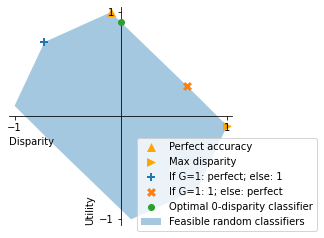

In [3]:
#Polygon
n_1pos=int(sum(y_train_male) + sum(y_evaluate_male))
n_1neg=int(sum(1-y_train_male) + sum(1-y_evaluate_male))
n_2pos=int(sum(y_train_female) + sum(y_evaluate_female))
n_2neg=int(sum(1-y_train_female) + sum(1-y_evaluate_female))

polygon_basic.plot_basic_polygon(n_1pos,n_1neg,n_2pos,n_2neg, lam=1, filename = 'figures/polygon_basic_'+'germancredittrain'+'.png')


## Sample LR

In [4]:
# Results
results_test = get_results_lr(X_train,
                   X_train_male,
                   X_train_female,
                   y_train,
                   y_train_male,
                   y_train_female,
                   X_evaluate,
                   X_evaluate_male,
                   X_evaluate_female,
                   y_evaluate,
                   y_evaluate_male,
                   y_evaluate_female,
                   X_test,
                   X_test_male,
                   X_test_female,
                   y_test,
                   y_test_male,
                   y_test_female,
                   ml_model = 'LR'
                   , search_procedure = 'sample'
                   , data = 'germancredit'
                   , lam = 1
                   , n_seeds = 10000
                   , n_rows_max = 50000
                   , filename = 'result_data/result_df.csv'
                             )

analysis_df_test = get_analysis(results_test
                ,n_trials_min = 2
                ,n_trials_max = 100
                ,m_samples_per_n_trial=2000
                ,m_samples_for_perfectguess_bootstrap=250
                ,n_rows_max = 50000
                ,filename='result_data/analysis_df.csv')


seed  0


/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


seed  100


/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-re

seed  200


/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-re

seed  300


/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


seed  400


/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-re

seed  500


/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-re

seed  600


/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-re

seed  700


/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


seed  800


/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-re

seed  900


/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-re

seed  1000


/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-re

seed  1100


/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-re

seed  1200


/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-re

seed  1300


/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-re

seed  1400


/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


seed  1500


/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-re

seed  1600
seed  1700


/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-re

seed  1800


/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-re

seed  1900


/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


seed  2000


/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-re

seed  2100


/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-re

seed  2200


/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


seed  2300


/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-re

seed  2400


/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-re

seed  2500


/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-re

seed  2600


/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-re

seed  2700


/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-re

seed  2800


/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-re

seed  2900


/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


seed  3000


/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-re

seed  3100


/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


seed  3200


/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-re

seed  3300


/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-re

seed  3400


/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-re

seed  3500


/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


seed  3600


/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-re

seed  3700


/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-re

seed  3800


/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-re

seed  3900


/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


seed  4000


/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-re

seed  4100


/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-re

seed  4200


/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-re

seed  4300


/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-re

seed  4400


/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-re

seed  4500


/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


seed  4600


/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-re

seed  4700


/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


seed  4800


/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-re

seed  4900


/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-re

seed  5000


/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-re

seed  5100


/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-re

seed  5200


/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-re

seed  5300


/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-re

seed  5400


/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-re

seed  5500


/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


seed  5600


/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-re

seed  5700


/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-re

seed  5800


/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-re

seed  5900


/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-re

seed  6000


/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-re

seed  6100


/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-re

seed  6200


/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-re

seed  6300


/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


seed  6400


/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-re

seed  6500


/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-re

seed  6600
seed  6700


/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-re

seed  6800


/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-re

seed  6900


/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-re

seed  7000


/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-re

seed  7100


/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-re

seed  7200


/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-re

seed  7300


/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-re

seed  7400


/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-re

seed  7500
seed  7600


/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-re

seed  7700
seed  7800


/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-re

seed  7900


/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-re

seed  8000


/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-re

seed  8100


/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


seed  8200


/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-re

seed  8300


/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-re

seed  8400


/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-re

seed  8500


/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-re

seed  8600


/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-re

seed  8700


/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-re

seed  8800


/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


seed  8900


/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-re

seed  9000


/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-re

seed  9100


/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-re

seed  9200


/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-re

seed  9300


/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


seed  9400


/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-re

seed  9500


/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-re

seed  9600


/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-re

seed  9700


/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-re

seed  9800


/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-re

seed  9900


/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/homebrew/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-re

Size of set:  20
Size of set:  40
Size of set:  60
Size of set:  80
Size of set:  100


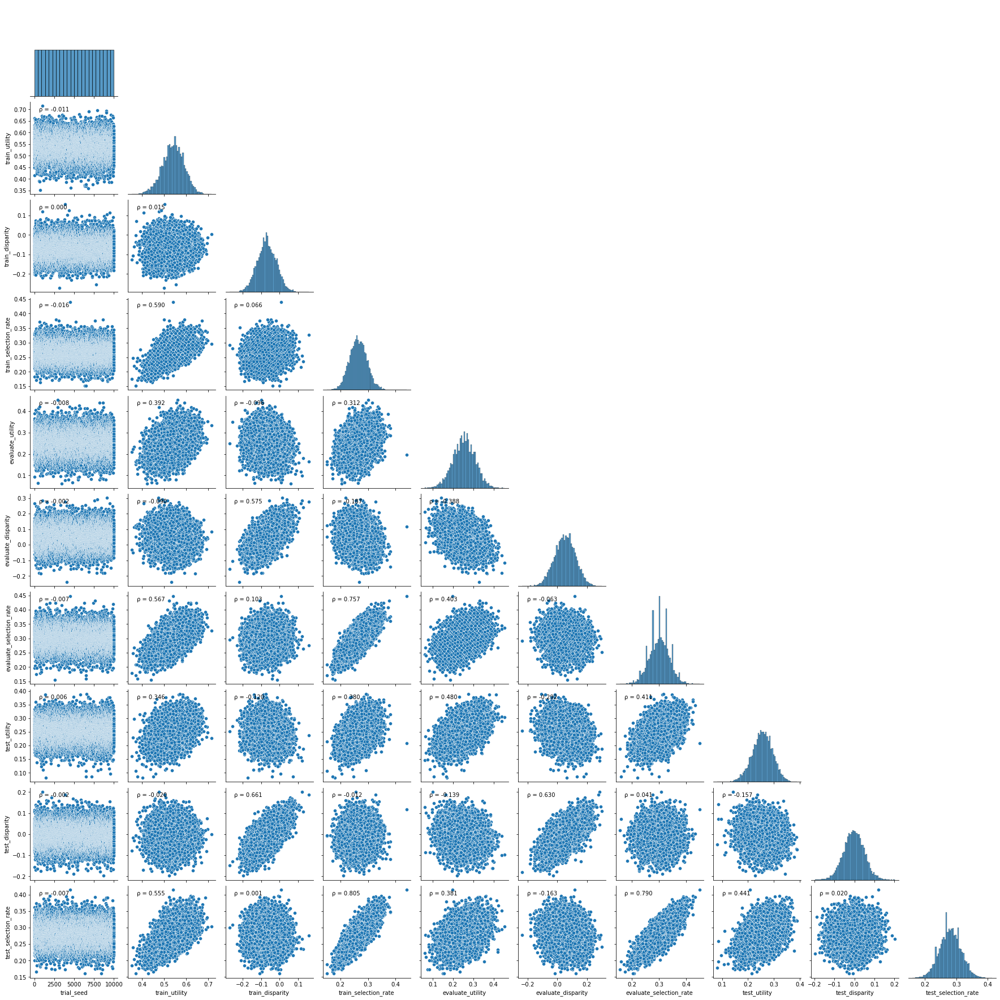

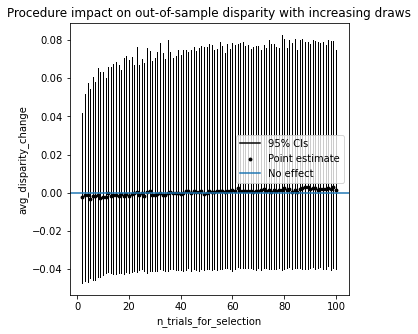

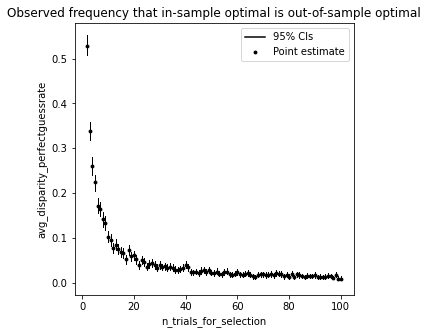

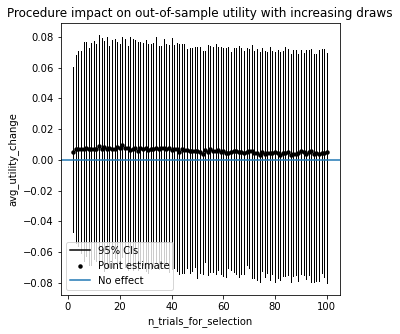

In [5]:
# Visualize
info_suffix='germancreditlrsampleTEST'

visualize_pairplot(results_test,info_suffix=info_suffix)

visualize_disputil(analysis_df_test,info_suffix=info_suffix)


## Sample DT

In [5]:
# Results
results_test = get_results_lr(X_train,
                   X_train_male,
                   X_train_female,
                   y_train,
                   y_train_male,
                   y_train_female,
                   X_evaluate,
                   X_evaluate_male,
                   X_evaluate_female,
                   y_evaluate,
                   y_evaluate_male,
                   y_evaluate_female,
                   X_test,
                   X_test_male,
                   X_test_female,
                   y_test,
                   y_test_male,
                   y_test_female,
                   ml_model = 'DT'
                   , search_procedure = 'sample'
                   , data = 'germancredit'
                   , lam = 1
                   , n_seeds = 10000
                   , n_rows_max = 50000
                   , filename = 'result_data/result_df.csv'
                             )

analysis_df_test = get_analysis(results_test
                ,n_trials_min = 2
                ,n_trials_max = 100
                ,m_samples_per_n_trial=2000
                ,m_samples_for_perfectguess_bootstrap=250
                ,n_rows_max = 50000
                ,filename='result_data/analysis_df.csv')


seed  0
seed  100
seed  200
seed  300
seed  400
seed  500
seed  600
seed  700
seed  800
seed  900
seed  1000
seed  1100
seed  1200
seed  1300
seed  1400
seed  1500
seed  1600
seed  1700
seed  1800
seed  1900
seed  2000
seed  2100
seed  2200
seed  2300
seed  2400
seed  2500
seed  2600
seed  2700
seed  2800
seed  2900
seed  3000
seed  3100
seed  3200
seed  3300
seed  3400
seed  3500
seed  3600
seed  3700
seed  3800
seed  3900
seed  4000
seed  4100
seed  4200
seed  4300
seed  4400
seed  4500
seed  4600
seed  4700
seed  4800
seed  4900
seed  5000
seed  5100
seed  5200
seed  5300
seed  5400
seed  5500
seed  5600
seed  5700
seed  5800
seed  5900
seed  6000
seed  6100
seed  6200
seed  6300
seed  6400
seed  6500
seed  6600
seed  6700
seed  6800
seed  6900
seed  7000
seed  7100
seed  7200
seed  7300
seed  7400
seed  7500
seed  7600
seed  7700
seed  7800
seed  7900
seed  8000
seed  8100
seed  8200
seed  8300
seed  8400
seed  8500
seed  8600
seed  8700
seed  8800
seed  8900
seed  9000
seed  9100


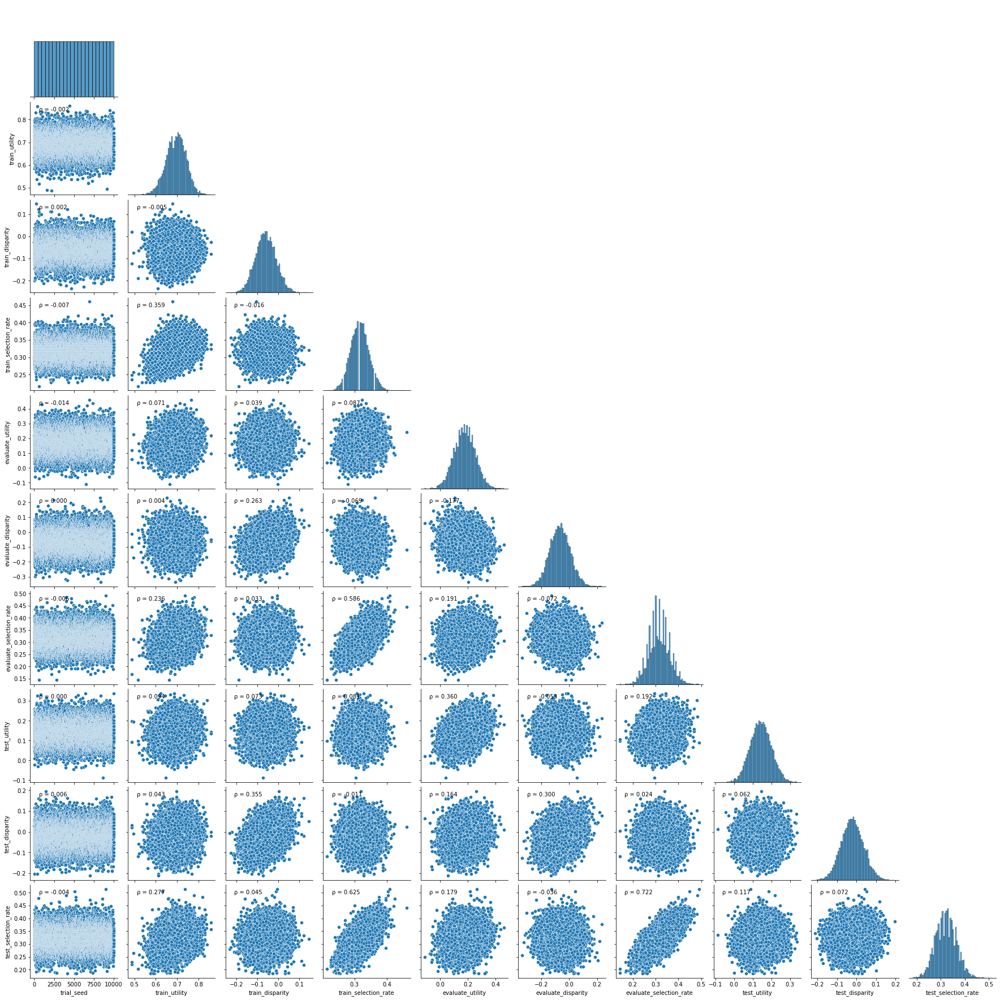

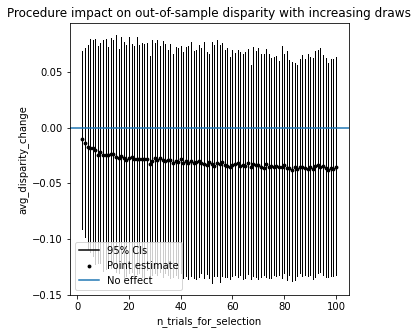

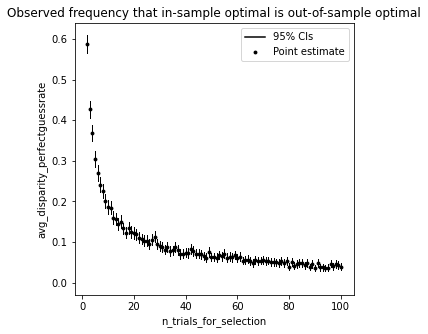

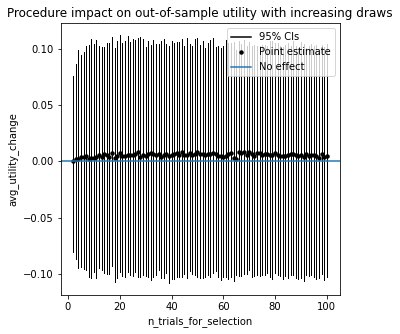

In [6]:
# Visualize
info_suffix='germancreditdtsample'

visualize_pairplot(results_test,info_suffix=info_suffix)

visualize_disputil(analysis_df_test,info_suffix=info_suffix)


## Sample RF

In [7]:
# Results
results_test = get_results_lr(X_train,
                   X_train_male,
                   X_train_female,
                   y_train,
                   y_train_male,
                   y_train_female,
                   X_evaluate,
                   X_evaluate_male,
                   X_evaluate_female,
                   y_evaluate,
                   y_evaluate_male,
                   y_evaluate_female,
                   X_test,
                   X_test_male,
                   X_test_female,
                   y_test,
                   y_test_male,
                   y_test_female,
                   ml_model = 'RF'
                   , search_procedure = 'sample'
                   , data = 'germancredit'
                   , lam = 1
                   , n_seeds = 10000
                   , n_rows_max = 50000
                   , filename = 'result_data/result_df.csv'
                             )

analysis_df_test = get_analysis(results_test
                ,n_trials_min = 2
                ,n_trials_max = 100
                ,m_samples_per_n_trial=2000
                ,m_samples_for_perfectguess_bootstrap=250
                ,n_rows_max = 50000
                ,filename='result_data/analysis_df.csv')


seed  0
seed  100
seed  200
seed  300
seed  400
seed  500
seed  600
seed  700
seed  800
seed  900
seed  1000
seed  1100
seed  1200
seed  1300
seed  1400
seed  1500
seed  1600
seed  1700
seed  1800
seed  1900
seed  2000
seed  2100
seed  2200
seed  2300
seed  2400
seed  2500
seed  2600
seed  2700
seed  2800
seed  2900
seed  3000
seed  3100
seed  3200
seed  3300
seed  3400
seed  3500
seed  3600
seed  3700
seed  3800
seed  3900
seed  4000
seed  4100
seed  4200
seed  4300
seed  4400
seed  4500
seed  4600
seed  4700
seed  4800
seed  4900
seed  5000
seed  5100
seed  5200
seed  5300
seed  5400
seed  5500
seed  5600
seed  5700
seed  5800
seed  5900
seed  6000
seed  6100
seed  6200
seed  6300
seed  6400
seed  6500
seed  6600
seed  6700
seed  6800
seed  6900
seed  7000
seed  7100
seed  7200
seed  7300
seed  7400
seed  7500
seed  7600
seed  7700
seed  7800
seed  7900
seed  8000
seed  8100
seed  8200
seed  8300
seed  8400
seed  8500
seed  8600
seed  8700
seed  8800
seed  8900
seed  9000
seed  9100


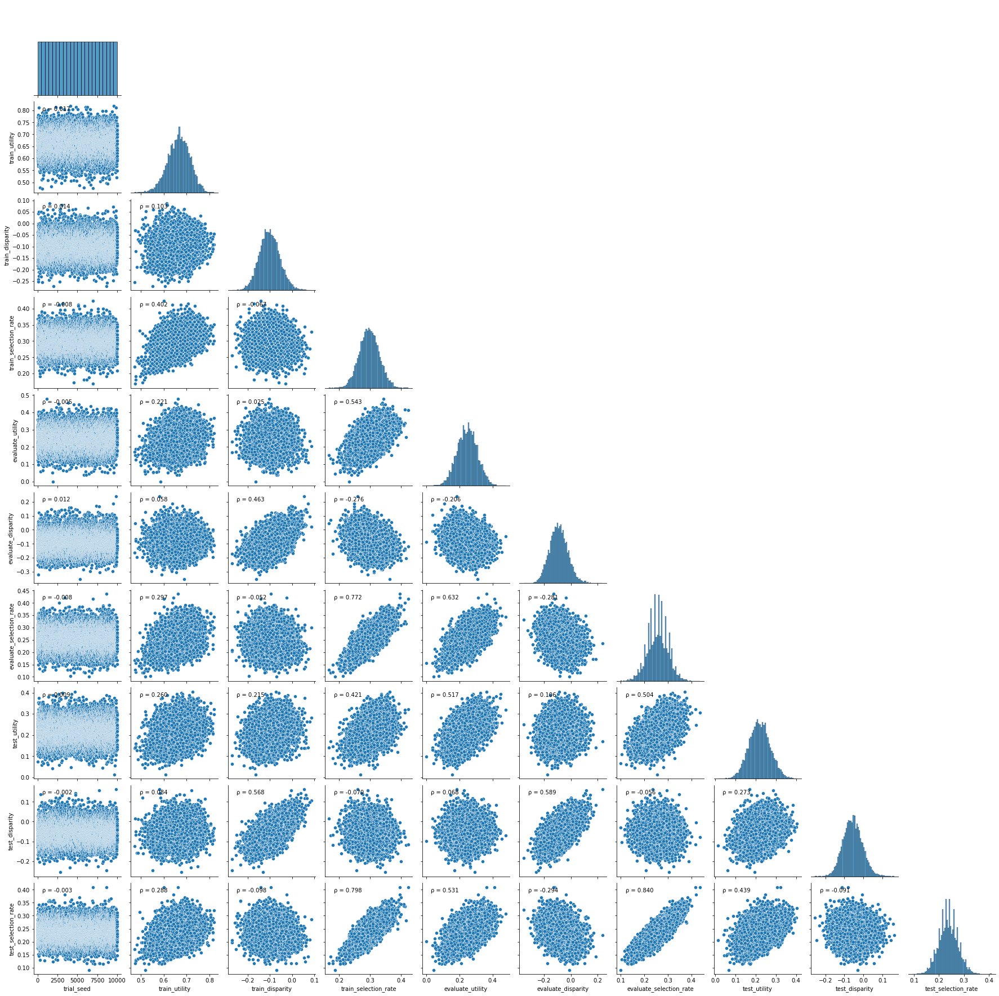

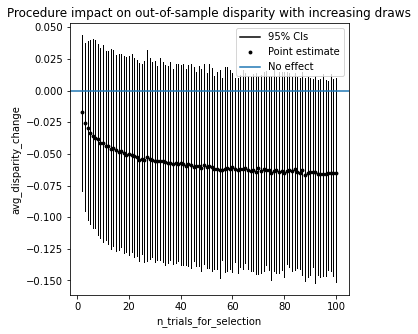

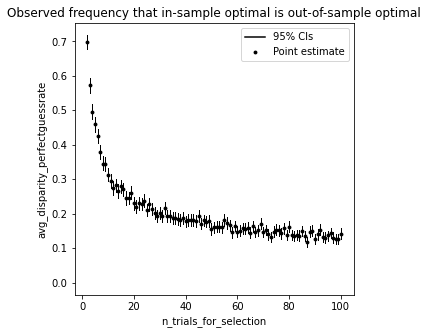

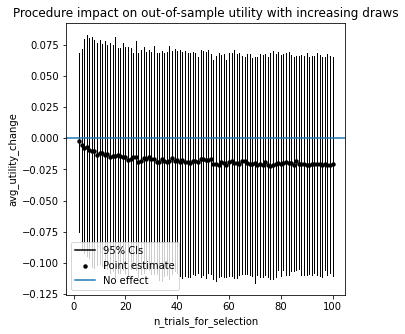

In [8]:
# Visualize
info_suffix='germancreditrfsample'

visualize_pairplot(results_test,info_suffix=info_suffix)

visualize_disputil(analysis_df_test,info_suffix=info_suffix)


## Random seed DT

In [9]:
# Results
results_test = get_results_lr(X_train,
                   X_train_male,
                   X_train_female,
                   y_train,
                   y_train_male,
                   y_train_female,
                   X_evaluate,
                   X_evaluate_male,
                   X_evaluate_female,
                   y_evaluate,
                   y_evaluate_male,
                   y_evaluate_female,
                   X_test,
                   X_test_male,
                   X_test_female,
                   y_test,
                   y_test_male,
                   y_test_female,
                   ml_model = 'DT'
                   , search_procedure = 'randomseed'
                   , data = 'germancredit'
                   , lam = 1
                   , n_seeds = 10000
                   , n_rows_max = 50000
                   , filename = 'result_data/result_df.csv'
                             )

analysis_df_test = get_analysis(results_test
                ,n_trials_min = 2
                ,n_trials_max = 100
                ,m_samples_per_n_trial=2000
                ,m_samples_for_perfectguess_bootstrap=250
                ,n_rows_max = 50000
                ,filename='result_data/analysis_df.csv')


seed  0
seed  100
seed  200
seed  300
seed  400
seed  500
seed  600
seed  700
seed  800
seed  900
seed  1000
seed  1100
seed  1200
seed  1300
seed  1400
seed  1500
seed  1600
seed  1700
seed  1800
seed  1900
seed  2000
seed  2100
seed  2200
seed  2300
seed  2400
seed  2500
seed  2600
seed  2700
seed  2800
seed  2900
seed  3000
seed  3100
seed  3200
seed  3300
seed  3400
seed  3500
seed  3600
seed  3700
seed  3800
seed  3900
seed  4000
seed  4100
seed  4200
seed  4300
seed  4400
seed  4500
seed  4600
seed  4700
seed  4800
seed  4900
seed  5000
seed  5100
seed  5200
seed  5300
seed  5400
seed  5500
seed  5600
seed  5700
seed  5800
seed  5900
seed  6000
seed  6100
seed  6200
seed  6300
seed  6400
seed  6500
seed  6600
seed  6700
seed  6800
seed  6900
seed  7000
seed  7100
seed  7200
seed  7300
seed  7400
seed  7500
seed  7600
seed  7700
seed  7800
seed  7900
seed  8000
seed  8100
seed  8200
seed  8300
seed  8400
seed  8500
seed  8600
seed  8700
seed  8800
seed  8900
seed  9000
seed  9100


/opt/homebrew/anaconda3/lib/python3.9/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/opt/homebrew/anaconda3/lib/python3.9/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/opt/homebrew/anaconda3/lib/python3.9/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/opt/homebrew/anaconda3/lib/python3.9/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/opt/homebrew/anaconda3/lib/python3.9/site-packages/scipy/stats/_stats_py.py:4781: ConstantInput

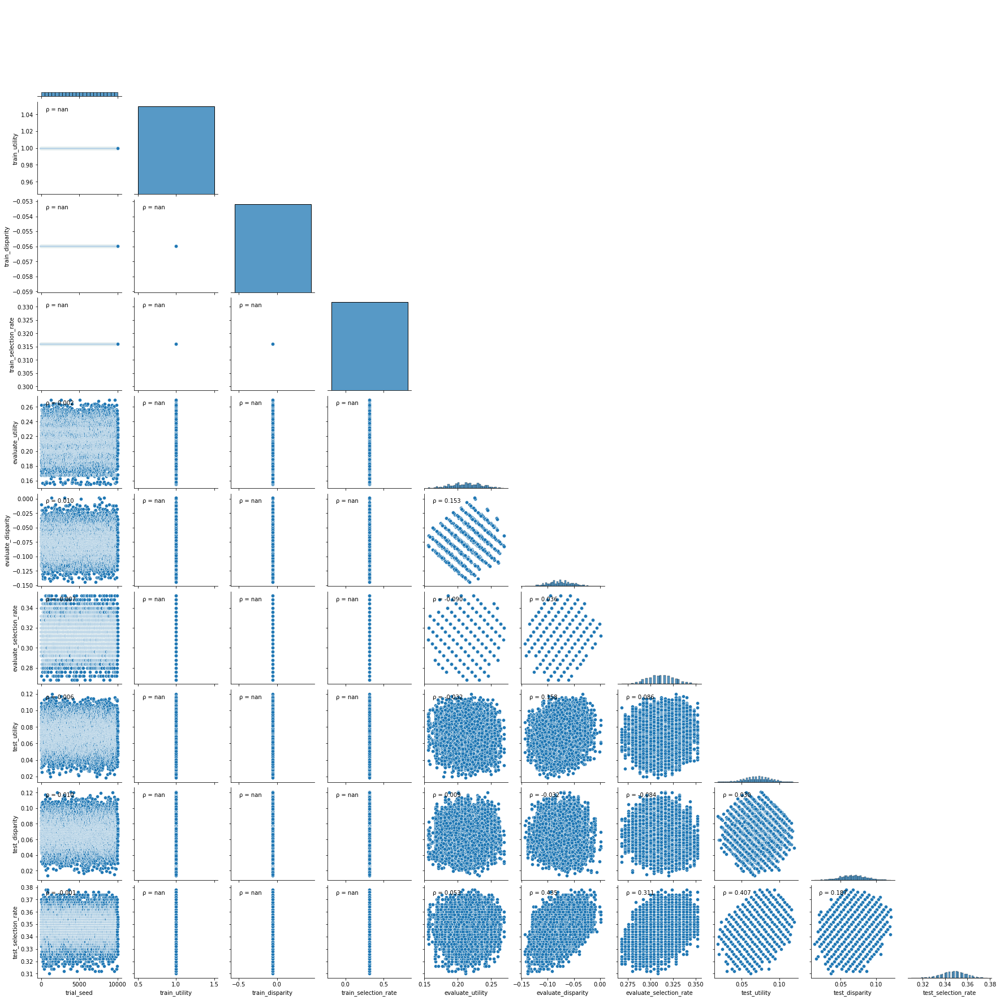

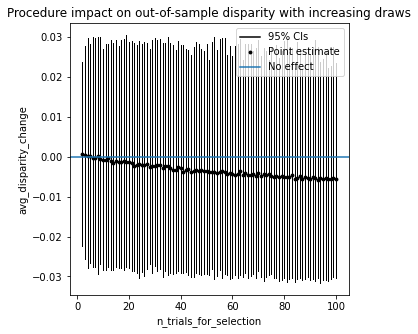

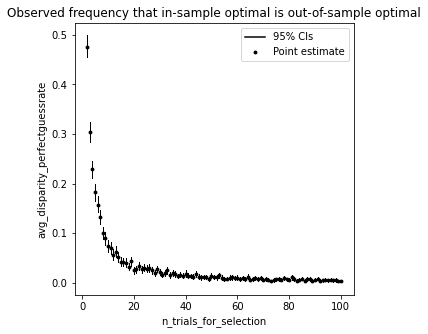

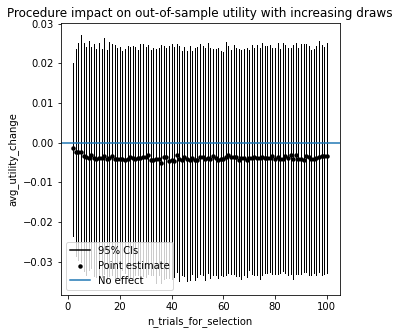

In [10]:
# Visualize
info_suffix='germancreditdtrandomseed'

visualize_pairplot(results_test,info_suffix=info_suffix)

visualize_disputil(analysis_df_test,info_suffix=info_suffix)


## Random Seed RF

In [11]:
# Results
results_test = get_results_lr(X_train,
                   X_train_male,
                   X_train_female,
                   y_train,
                   y_train_male,
                   y_train_female,
                   X_evaluate,
                   X_evaluate_male,
                   X_evaluate_female,
                   y_evaluate,
                   y_evaluate_male,
                   y_evaluate_female,
                   X_test,
                   X_test_male,
                   X_test_female,
                   y_test,
                   y_test_male,
                   y_test_female,
                   ml_model = 'RF'
                   , search_procedure = 'randomseed'
                   , data = 'germancredit'
                   , lam = 1
                   , n_seeds = 10000
                   , n_rows_max = 50000
                   , filename = 'result_data/result_df.csv'
                             )

analysis_df_test = get_analysis(results_test
                ,n_trials_min = 2
                ,n_trials_max = 100
                ,m_samples_per_n_trial=2000
                ,m_samples_for_perfectguess_bootstrap=250
                ,n_rows_max = 50000
                ,filename='result_data/analysis_df.csv')


seed  0
seed  100
seed  200
seed  300
seed  400
seed  500
seed  600
seed  700
seed  800
seed  900
seed  1000
seed  1100
seed  1200
seed  1300
seed  1400
seed  1500
seed  1600
seed  1700
seed  1800
seed  1900
seed  2000
seed  2100
seed  2200
seed  2300
seed  2400
seed  2500
seed  2600
seed  2700
seed  2800
seed  2900
seed  3000
seed  3100
seed  3200
seed  3300
seed  3400
seed  3500
seed  3600
seed  3700
seed  3800
seed  3900
seed  4000
seed  4100
seed  4200
seed  4300
seed  4400
seed  4500
seed  4600
seed  4700
seed  4800
seed  4900
seed  5000
seed  5100
seed  5200
seed  5300
seed  5400
seed  5500
seed  5600
seed  5700
seed  5800
seed  5900
seed  6000
seed  6100
seed  6200
seed  6300
seed  6400
seed  6500
seed  6600
seed  6700
seed  6800
seed  6900
seed  7000
seed  7100
seed  7200
seed  7300
seed  7400
seed  7500
seed  7600
seed  7700
seed  7800
seed  7900
seed  8000
seed  8100
seed  8200
seed  8300
seed  8400
seed  8500
seed  8600
seed  8700
seed  8800
seed  8900
seed  9000
seed  9100


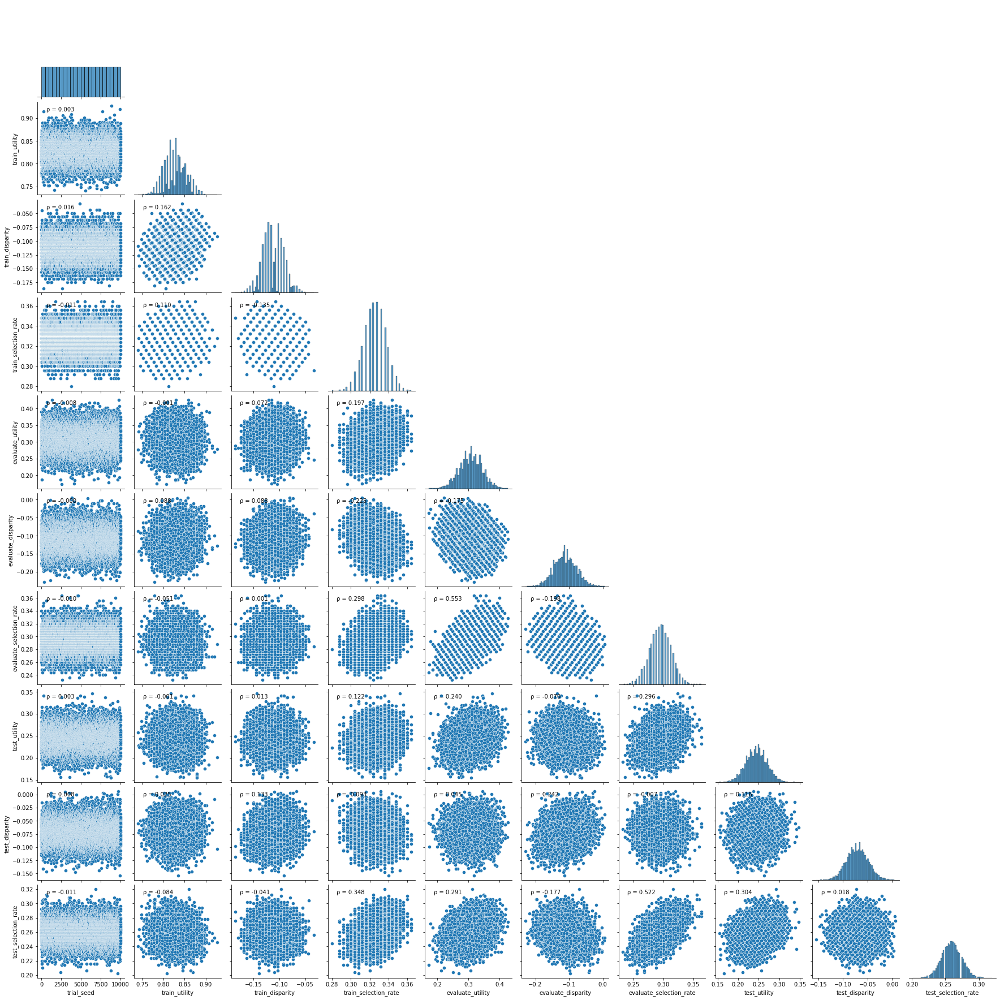

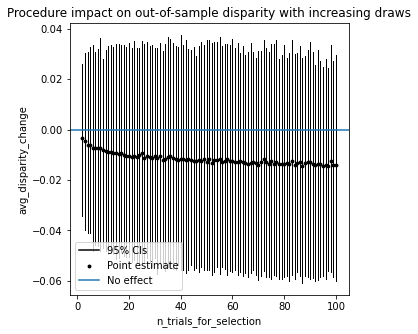

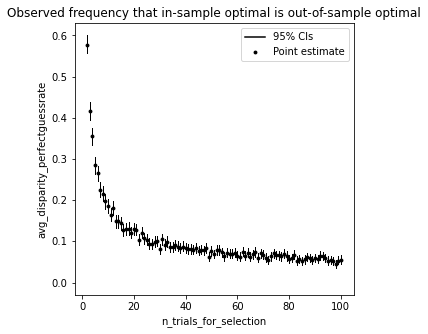

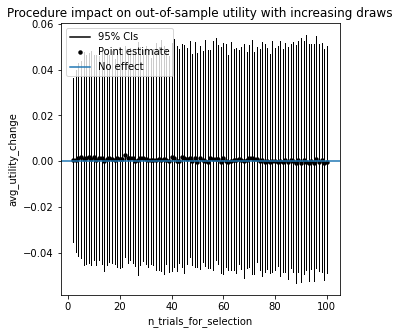

In [12]:
# Visualize
info_suffix='germancreditrfrandomseed'

visualize_pairplot(results_test,info_suffix=info_suffix)

visualize_disputil(analysis_df_test,info_suffix=info_suffix)


# ADULT

In [18]:
# Data wrangling

adult = pd.read_csv('adult/adult.data',names = ['age',
'workclass',
'fnlwgt',
'education',
'educationnum',
'maritalstatus',
'occupation',
'relationship',
'race',
'sex',
'capitalgain',
'capitalloss',
'hoursperweek',
'nativecountry','target'],index_col=False)
adult['y'] = np.where(adult['target']==' <=50K',0,1)

y_withsex,X_withsex = patsy.dmatrices('y ~ sex + maritalstatus + hoursperweek + education + workclass - 1',data=adult)
y,X = patsy.dmatrices('y ~ maritalstatus + hoursperweek + education + workclass - 1',data=adult)

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = .5,random_state=1)
X_train_s, X_test_s, y_train_s, y_test_s = train_test_split(X_withsex, y_withsex, test_size = .5,random_state=1)

#Which index is the sex variable?
s_index = 1
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = .5,random_state=1)
X_train_s, X_test_s, y_train_s, y_test_s = train_test_split(X_withsex, y_withsex, test_size = .5,random_state=1)

X_train, X_evaluate, y_train, y_evaluate = train_test_split(X_train, y_train, test_size = .5,random_state=1)
X_train_s, X_evaluate_s, y_train_s, y_evaluate_s = train_test_split(X_train_s, y_train_s, test_size = .5,random_state=1)

#Which index is the sex variable?
s_index = 1

X_test_male = X_test[X_test_s[:,s_index]==1]
y_test_male = y_test[X_test_s[:,s_index]==1]
X_test_female = X_test[X_test_s[:,s_index]==0]
y_test_female = y_test[X_test_s[:,s_index]==0]

X_train_male = X_train[X_train_s[:,s_index]==1]
y_train_male = y_train[X_train_s[:,s_index]==1]
X_train_female = X_train[X_train_s[:,s_index]==0]
y_train_female = y_train[X_train_s[:,s_index]==0]

X_evaluate_male = X_evaluate[X_evaluate_s[:,s_index]==1]
y_evaluate_male = y_evaluate[X_evaluate_s[:,s_index]==1]
X_evaluate_female = X_evaluate[X_evaluate_s[:,s_index]==0]
y_evaluate_female = y_evaluate[X_evaluate_s[:,s_index]==0]


In [19]:
adult

,age,workclass,fnlwgt,education,educationnum,maritalstatus,occupation,relationship,race,sex,capitalgain,capitalloss,hoursperweek,nativecountry,target,y
0,39,State-gov,77516,Bachelors,13,Never-married,Adm-clerical,Not-in-family,White,Male,2174,0,40,United-States,<=50K,0
1,50,Self-emp-not-inc,83311,Bachelors,13,Married-civ-spouse,Exec-managerial,Husband,White,Male,0,0,13,United-States,<=50K,0
2,38,Private,215646,HS-grad,9,Divorced,Handlers-cleaners,Not-in-family,White,Male,0,0,40,United-States,<=50K,0
3,53,Private,234721,11th,7,Married-civ-spouse,Handlers-cleaners,Husband,Black,Male,0,0,40,United-States,<=50K,0
4,28,Private,338409,Bachelors,13,Married-civ-spouse,Prof-specialty,Wife,Black,Female,0,0,40,Cuba,<=50K,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
32556,27,Private,257302,Assoc-acdm,12,Married-civ-spouse,Tech-support,Wife,White,Female,0,0,38,United-States,<=50K,0
32557,40,Private,154374,HS-grad,9,Married-civ-spouse,Machine-op-inspct,Husband,White,Male,0,0,40,United-States,>50K,1
32558,58,Private,151910,HS-grad,9,Widowed,Adm-clerical,Unmarried,White,Female,0,0,40,United-States,<=50K,0
32559,22,Private,201490,HS-grad,9,Never-married,Adm-clerical,Own-child,White,Male,0,0,20,United-States,<=50K,0


/var/folders/35/rbf5cr3s6wx53bzp489khqh40000gn/T/ipykernel_33981/3702976812.py:2: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  n_1pos=int(sum(y_train_male) + sum(y_evaluate_male))
/var/folders/35/rbf5cr3s6wx53bzp489khqh40000gn/T/ipykernel_33981/3702976812.py:3: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  n_1neg=int(sum(1-y_train_male) + sum(1-y_evaluate_male))
/var/folders/35/rbf5cr3s6wx53bzp489khqh40000gn/T/ipykernel_33981/3702976812.py:4: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (D

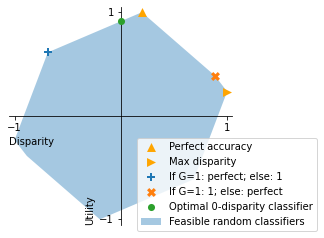

In [3]:
#Polygon
n_1pos=int(sum(y_train_male) + sum(y_evaluate_male))
n_1neg=int(sum(1-y_train_male) + sum(1-y_evaluate_male))
n_2pos=int(sum(y_train_female) + sum(y_evaluate_female))
n_2neg=int(sum(1-y_train_female) + sum(1-y_evaluate_female))

polygon_basic.plot_basic_polygon(n_1pos,n_1neg,n_2pos,n_2neg, lam=1, filename = 'figures/polygon_basic_'+'adulttrain'+'.png')


/var/folders/35/rbf5cr3s6wx53bzp489khqh40000gn/T/ipykernel_40940/859394225.py:2: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  n_1pos=int(sum(y_train_male) + sum(y_evaluate_male))
/var/folders/35/rbf5cr3s6wx53bzp489khqh40000gn/T/ipykernel_40940/859394225.py:3: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  n_1neg=int(sum(1-y_train_male) + sum(1-y_evaluate_male))
/var/folders/35/rbf5cr3s6wx53bzp489khqh40000gn/T/ipykernel_40940/859394225.py:4: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Depr

3418 7501 618 4743
[ 0.13533528  0.14867389  0.16332716  0.17942464  0.19710869  0.21653567
  0.23787737  0.2613225   0.28707838  0.31537275  0.34645581  0.38060241
  0.41811448  0.45932374  0.50459457  0.55432728  0.60896164  0.66898075
  0.73491532  0.80734839  0.88692044  0.97433509  1.07036531  1.17586024
  1.29175273  1.41906755  1.55893049  1.71257828  1.88136956  2.06679686
  2.27049984  2.49427972  2.7401153   3.01018037  3.30686298  3.63278656
  3.99083308  4.38416857  4.81627111  5.29096157  5.81243739  6.38530975
  7.01464425  7.70600581  8.46550778  9.29986608 10.21645852 11.22339007
 12.32956455 13.5447633  14.87973172]


/opt/homebrew/anaconda3/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/opt/homebrew/anaconda3/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/opt/homebrew/anaconda3/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.w

/opt/homebrew/anaconda3/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/opt/homebrew/anaconda3/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/opt/homebrew/anaconda3/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.w

/opt/homebrew/anaconda3/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/opt/homebrew/anaconda3/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/opt/homebrew/anaconda3/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.w

/opt/homebrew/anaconda3/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/opt/homebrew/anaconda3/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/opt/homebrew/anaconda3/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.w

/opt/homebrew/anaconda3/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/opt/homebrew/anaconda3/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/opt/homebrew/anaconda3/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.w

/opt/homebrew/anaconda3/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/opt/homebrew/anaconda3/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/opt/homebrew/anaconda3/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.w

/opt/homebrew/anaconda3/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/opt/homebrew/anaconda3/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/opt/homebrew/anaconda3/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.w

/opt/homebrew/anaconda3/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/opt/homebrew/anaconda3/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/opt/homebrew/anaconda3/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.w

/opt/homebrew/anaconda3/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/opt/homebrew/anaconda3/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/opt/homebrew/anaconda3/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.w

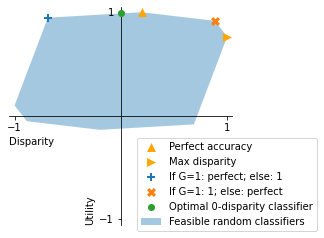

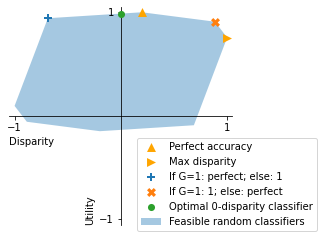

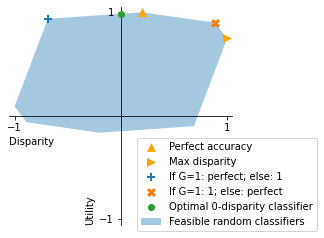

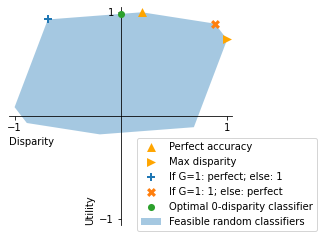

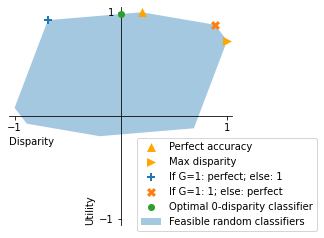

...

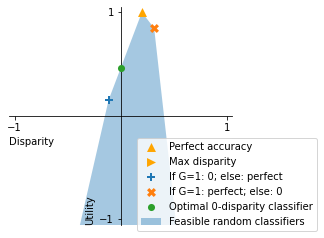

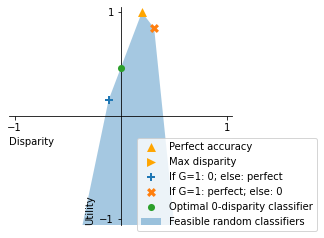

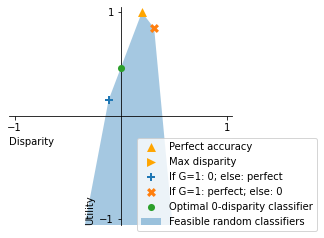

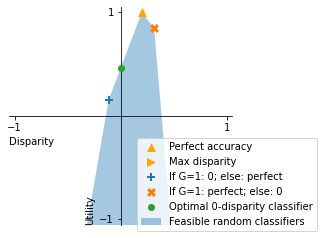

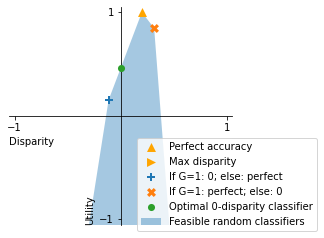

In [179]:
#Polygon
n_1pos=int(sum(y_train_male) + sum(y_evaluate_male))
n_1neg=int(sum(1-y_train_male) + sum(1-y_evaluate_male))
n_2pos=int(sum(y_train_female) + sum(y_evaluate_female))
n_2neg=int(sum(1-y_train_female) + sum(1-y_evaluate_female))
print(n_1pos,n_1neg,n_2pos,n_2neg)

logrange = list(np.linspace(-2,2.7,51))
print(np.exp(np.array(logrange)))

all_xs = []
all_ys = []
for lam in np.exp(np.array(logrange)):
    xs, ys = polygon_basic.plot_basic_polygon(n_1pos,n_1neg,n_2pos,n_2neg, lam=lam, filename = 'figures/polygon_basic_'+'adulttrainlambda%.2f'%lam+'.png')
    all_xs.append(xs)
    all_ys.append(ys)
    
#for lam in range(0.01,)[.001,.005,.01,.05,.1,.5,1,5,10,50,100]:
#    polygon_basic.plot_basic_polygon(n_1pos,n_1neg,n_2pos,n_2neg, lam=lam, filename = 'figures/polygon_basic_'+'adulttrainlambda%.2f'%lam+'.png')


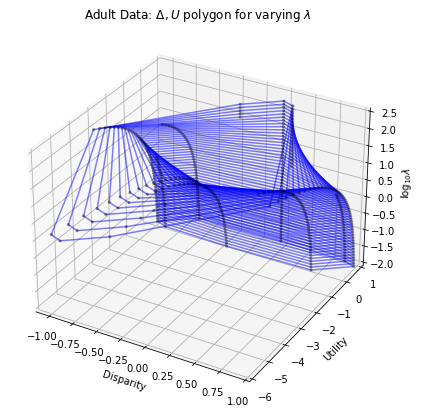

In [212]:

fig = plt.figure(figsize=[7,7])
ax = fig.add_subplot( projection='3d')

#plt.figure(figsize=[6,6])
#ax = plt.subplot(projection='3d',)
#all_ys_save = all_ys.copy()
#all_ys = np.logarithm(all_ys)
colors = plt.cm.rainbow(np.linspace(0, 1, 8))
for i in range(len(logrange[:-5])):
    ax.scatter(list(np.array(all_xs).ravel()[i*8:(i+1)*8])
            ,np.maximum(list(np.array(all_ys).ravel()[i*8:(i+1)*8]),-20)
            ,[logrange[i]]*8#list(logrange*8)[i]
            ,alpha=0.3
            ,c='black'
            ,s=5
            #,c=colors
           )
    ax.plot(list(np.array(all_xs).ravel()[i*8:(i+1)*8])+[np.array(all_xs).ravel()[i*8]]
            ,np.maximum(list(np.array(all_ys).ravel()[i*8:(i+1)*8])+[np.array(all_ys).ravel()[i*8]],-20)
            ,[logrange[i]]*9#list(logrange*8)[i]
            ,c='blue'
            ,alpha=0.5
            #,c=colors
           )
    #ax.fill(np.array(all_xs).ravel()[i*8:(i+1)*8],np.array(all_ys).ravel()[i*8:(i+1)*8],label='Feasible random classifiers',color='#1f77b4',alpha=0.2,linewidth=0,zorder=-1)
    
ax.set_xlim([-1.1,1])
ax.set_xlabel('Disparity')
ax.set_ylim([-6,1])
ax.set_ylabel('Utility')

#ax.set_yscale('log')
#ax.set_yscale('symlog')

ax.set_zlim([-2,2.5])
ax.set_zlabel('$\log_{10} \lambda$')

ax.set_title('Adult Data: $\Delta, U$ polygon for varying $\lambda$')

plt.show()

In [150]:
from mpl_toolkits.mplot3d import Axes3D


In [208]:
all_ys[0]

array([ 1.        ,  0.94757471,  0.10069661, -0.05242529, -0.13533528,
       -0.08290999,  0.7639681 ,  0.91709001])

In [23]:
len(np.array(all_ys).ravel())

408

## Sample LR

In [21]:
# Results
results_test = get_results_lr(X_train,
                   X_train_male,
                   X_train_female,
                   y_train,
                   y_train_male,
                   y_train_female,
                   X_evaluate,
                   X_evaluate_male,
                   X_evaluate_female,
                   y_evaluate,
                   y_evaluate_male,
                   y_evaluate_female,
                   X_test,
                   X_test_male,
                   X_test_female,
                   y_test,
                   y_test_male,
                   y_test_female,
                   ml_model = 'LR'
                   , search_procedure = 'sample'
                   , data = 'adult'
                   , lam = 1
                   , n_seeds = 10000
                   , n_rows_max = 50000
                   , filename = 'result_data/result_df.csv'
                             )

analysis_df_test = get_analysis(results_test
                ,n_trials_min = 2
                ,n_trials_max = 100
                ,m_samples_per_n_trial=2000
                ,m_samples_for_perfectguess_bootstrap=250
                ,n_rows_max = 50000
                ,filename='result_data/analysis_df.csv')


seed  0
seed  100
seed  200
seed  300
seed  400
seed  500
seed  600
seed  700
seed  800
seed  900
seed  1000
seed  1100
seed  1200
seed  1300
seed  1400
seed  1500
seed  1600
seed  1700
seed  1800
seed  1900
seed  2000
seed  2100
seed  2200
seed  2300
seed  2400
seed  2500
seed  2600
seed  2700
seed  2800
seed  2900
seed  3000
seed  3100
seed  3200
seed  3300
seed  3400
seed  3500
seed  3600
seed  3700
seed  3800
seed  3900
seed  4000
seed  4100
seed  4200
seed  4300
seed  4400
seed  4500
seed  4600
seed  4700
seed  4800
seed  4900
seed  5000
seed  5100
seed  5200
seed  5300
seed  5400
seed  5500
seed  5600
seed  5700
seed  5800
seed  5900
seed  6000
seed  6100
seed  6200
seed  6300
seed  6400
seed  6500
seed  6600
seed  6700
seed  6800
seed  6900
seed  7000
seed  7100
seed  7200
seed  7300
seed  7400
seed  7500
seed  7600
seed  7700
seed  7800
seed  7900
seed  8000
seed  8100
seed  8200
seed  8300
seed  8400
seed  8500
seed  8600
seed  8700
seed  8800
seed  8900
seed  9000
seed  9100


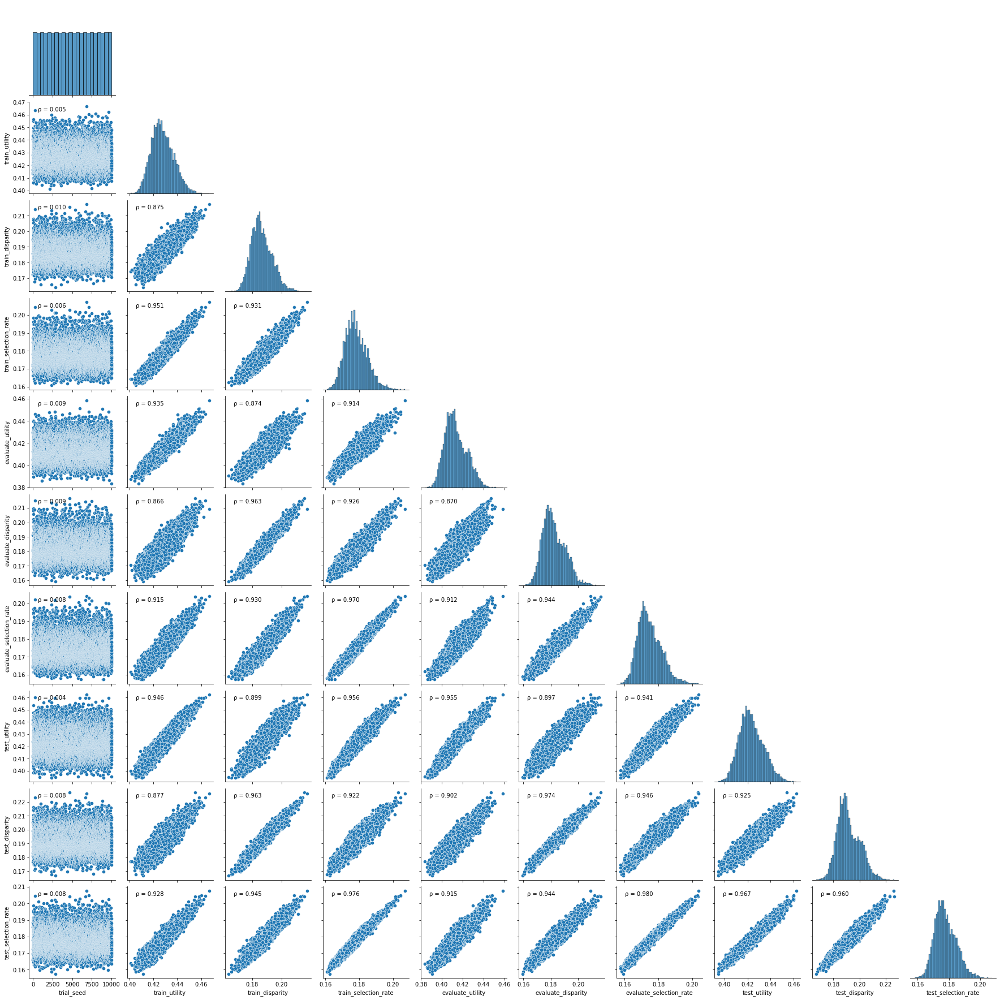

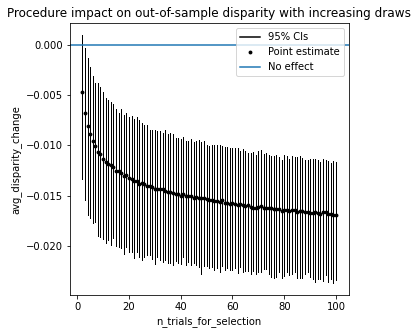

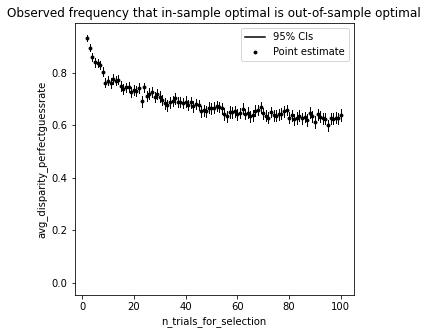

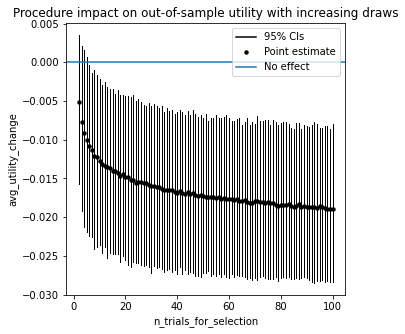

In [22]:
# Visualize
info_suffix='adultlrsample'

visualize_pairplot(results_test,info_suffix=info_suffix)

visualize_disputil(analysis_df_test,info_suffix=info_suffix)


## Sample DT

In [23]:
# Results
results_test = get_results_lr(X_train,
                   X_train_male,
                   X_train_female,
                   y_train,
                   y_train_male,
                   y_train_female,
                   X_evaluate,
                   X_evaluate_male,
                   X_evaluate_female,
                   y_evaluate,
                   y_evaluate_male,
                   y_evaluate_female,
                   X_test,
                   X_test_male,
                   X_test_female,
                   y_test,
                   y_test_male,
                   y_test_female,
                   ml_model = 'DT'
                   , search_procedure = 'sample'
                   , data = 'adult'
                   , lam = 1
                   , n_seeds = 10000
                   , n_rows_max = 50000
                   , filename = 'result_data/result_df.csv'
                             )

analysis_df_test = get_analysis(results_test
                ,n_trials_min = 2
                ,n_trials_max = 100
                ,m_samples_per_n_trial=2000
                ,m_samples_for_perfectguess_bootstrap=250
                ,n_rows_max = 50000
                ,filename='result_data/analysis_df.csv')


seed  0
seed  100
seed  200
seed  300
seed  400
seed  500
seed  600
seed  700
seed  800
seed  900
seed  1000
seed  1100
seed  1200
seed  1300
seed  1400
seed  1500
seed  1600
seed  1700
seed  1800
seed  1900
seed  2000
seed  2100
seed  2200
seed  2300
seed  2400
seed  2500
seed  2600
seed  2700
seed  2800
seed  2900
seed  3000
seed  3100
seed  3200
seed  3300
seed  3400
seed  3500
seed  3600
seed  3700
seed  3800
seed  3900
seed  4000
seed  4100
seed  4200
seed  4300
seed  4400
seed  4500
seed  4600
seed  4700
seed  4800
seed  4900
seed  5000
seed  5100
seed  5200
seed  5300
seed  5400
seed  5500
seed  5600
seed  5700
seed  5800
seed  5900
seed  6000
seed  6100
seed  6200
seed  6300
seed  6400
seed  6500
seed  6600
seed  6700
seed  6800
seed  6900
seed  7000
seed  7100
seed  7200
seed  7300
seed  7400
seed  7500
seed  7600
seed  7700
seed  7800
seed  7900
seed  8000
seed  8100
seed  8200
seed  8300
seed  8400
seed  8500
seed  8600
seed  8700
seed  8800
seed  8900
seed  9000
seed  9100


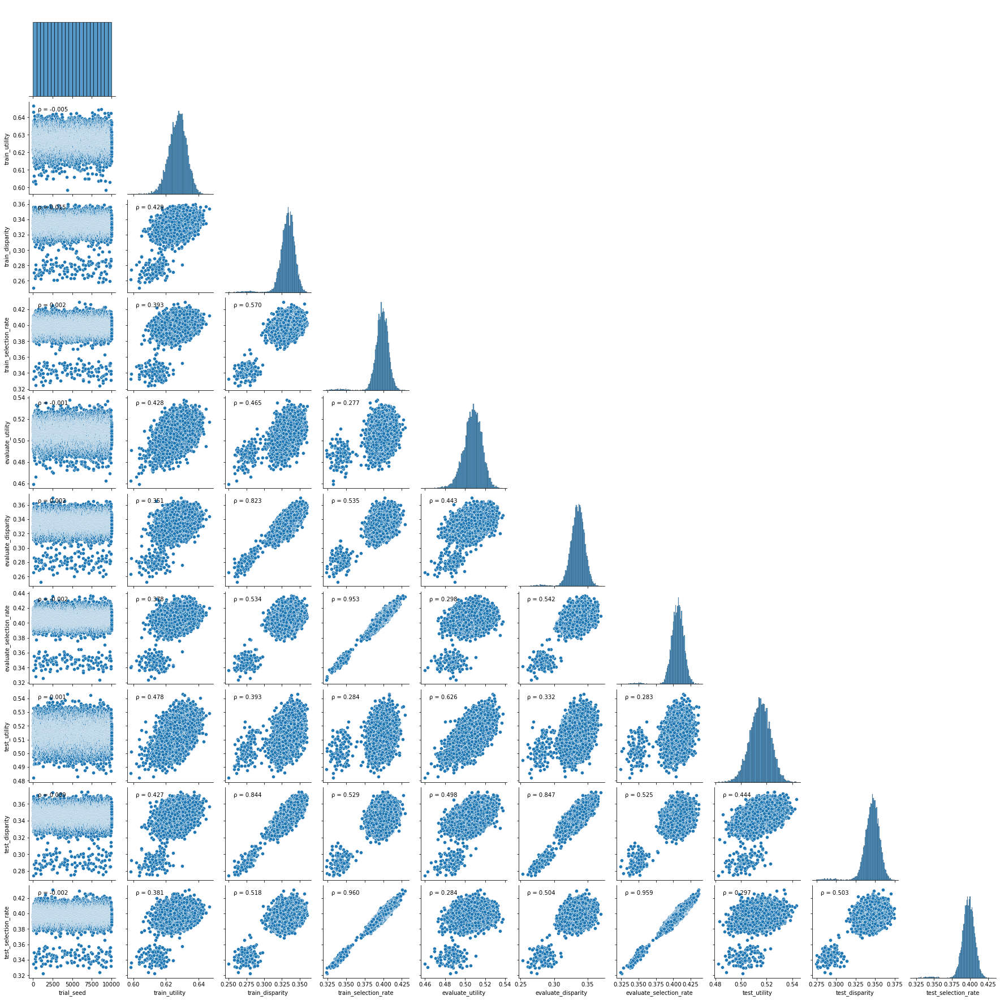

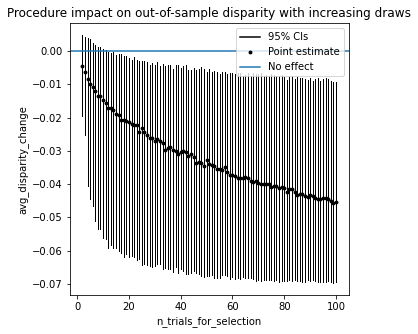

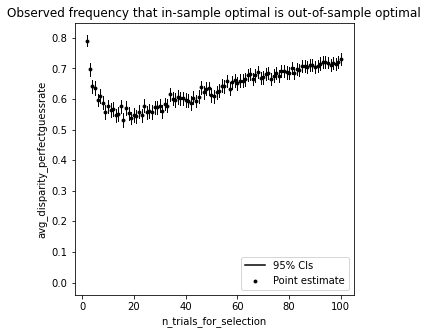

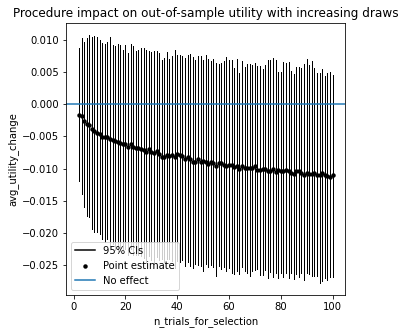

In [24]:
# Visualize
info_suffix='adultdtsample'

visualize_pairplot(results_test,info_suffix=info_suffix)

visualize_disputil(analysis_df_test,info_suffix=info_suffix)


## Sample RF

In [25]:
# Results
results_test = get_results_lr(X_train,
                   X_train_male,
                   X_train_female,
                   y_train,
                   y_train_male,
                   y_train_female,
                   X_evaluate,
                   X_evaluate_male,
                   X_evaluate_female,
                   y_evaluate,
                   y_evaluate_male,
                   y_evaluate_female,
                   X_test,
                   X_test_male,
                   X_test_female,
                   y_test,
                   y_test_male,
                   y_test_female,
                   ml_model = 'RF'
                   , search_procedure = 'sample'
                   , data = 'adult'
                   , lam = 1
                   , n_seeds = 10000
                   , n_rows_max = 50000
                   , filename = 'result_data/result_df.csv'
                             )

analysis_df_test = get_analysis(results_test
                ,n_trials_min = 2
                ,n_trials_max = 100
                ,m_samples_per_n_trial=2000
                ,m_samples_for_perfectguess_bootstrap=250
                ,n_rows_max = 50000
                ,filename='result_data/analysis_df.csv')


seed  0
seed  100
seed  200
seed  300
seed  400
seed  500
seed  600
seed  700
seed  800
seed  900
seed  1000
seed  1100
seed  1200
seed  1300
seed  1400
seed  1500
seed  1600
seed  1700
seed  1800
seed  1900
seed  2000
seed  2100
seed  2200
seed  2300
seed  2400
seed  2500
seed  2600
seed  2700
seed  2800
seed  2900
seed  3000
seed  3100
seed  3200
seed  3300
seed  3400
seed  3500
seed  3600
seed  3700
seed  3800
seed  3900
seed  4000
seed  4100
seed  4200
seed  4300
seed  4400
seed  4500
seed  4600
seed  4700
seed  4800
seed  4900
seed  5000
seed  5100
seed  5200
seed  5300
seed  5400
seed  5500
seed  5600
seed  5700
seed  5800
seed  5900
seed  6000
seed  6100
seed  6200
seed  6300
seed  6400
seed  6500
seed  6600
seed  6700
seed  6800
seed  6900
seed  7000
seed  7100
seed  7200
seed  7300
seed  7400
seed  7500
seed  7600
seed  7700
seed  7800
seed  7900
seed  8000
seed  8100
seed  8200
seed  8300
seed  8400
seed  8500
seed  8600
seed  8700
seed  8800
seed  8900
seed  9000
seed  9100


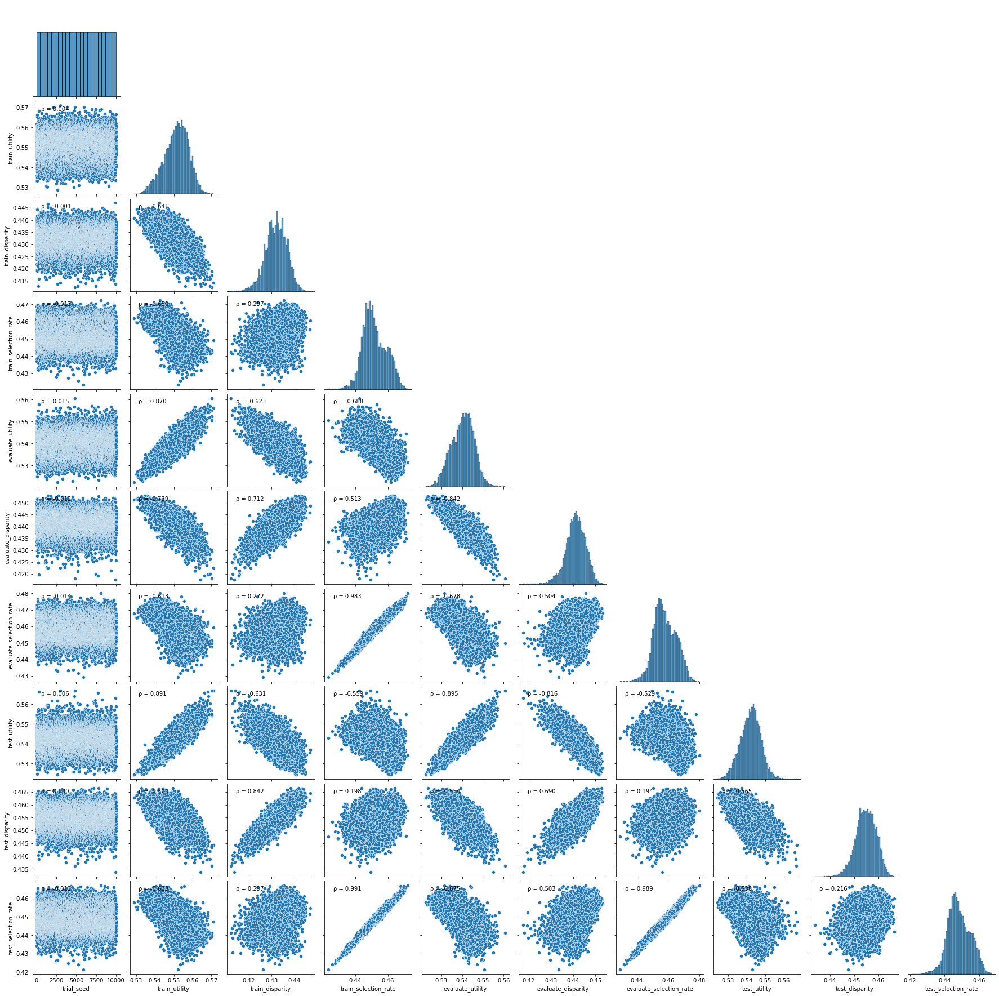

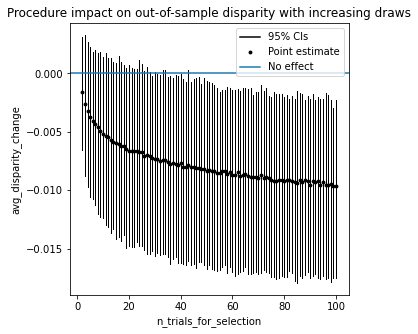

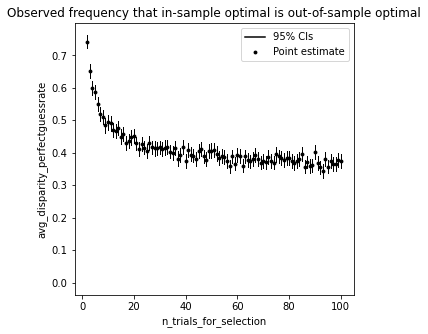

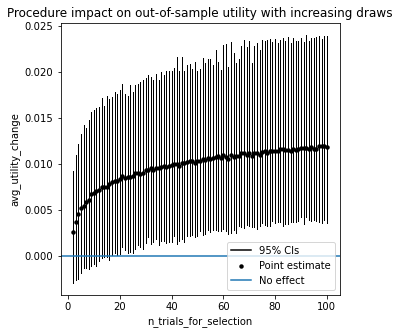

In [26]:
# Visualize
info_suffix='adultrfsample'

visualize_pairplot(results_test,info_suffix=info_suffix)

visualize_disputil(analysis_df_test,info_suffix=info_suffix)


## Random Seed DT

In [27]:
# Results
results_test = get_results_lr(X_train,
                   X_train_male,
                   X_train_female,
                   y_train,
                   y_train_male,
                   y_train_female,
                   X_evaluate,
                   X_evaluate_male,
                   X_evaluate_female,
                   y_evaluate,
                   y_evaluate_male,
                   y_evaluate_female,
                   X_test,
                   X_test_male,
                   X_test_female,
                   y_test,
                   y_test_male,
                   y_test_female,
                   ml_model = 'DT'
                   , search_procedure = 'randomseed'
                   , data = 'adult'
                   , lam = 1
                   , n_seeds = 10000
                   , n_rows_max = 50000
                   , filename = 'result_data/result_df.csv'
                             )

analysis_df_test = get_analysis(results_test
                ,n_trials_min = 2
                ,n_trials_max = 100
                ,m_samples_per_n_trial=2000
                ,m_samples_for_perfectguess_bootstrap=250
                ,n_rows_max = 50000
                ,filename='result_data/analysis_df.csv')


seed  0
seed  100
seed  200
seed  300
seed  400
seed  500
seed  600
seed  700
seed  800
seed  900
seed  1000
seed  1100
seed  1200
seed  1300
seed  1400
seed  1500
seed  1600
seed  1700
seed  1800
seed  1900
seed  2000
seed  2100
seed  2200
seed  2300
seed  2400
seed  2500
seed  2600
seed  2700
seed  2800
seed  2900
seed  3000
seed  3100
seed  3200
seed  3300
seed  3400
seed  3500
seed  3600
seed  3700
seed  3800
seed  3900
seed  4000
seed  4100
seed  4200
seed  4300
seed  4400
seed  4500
seed  4600
seed  4700
seed  4800
seed  4900
seed  5000
seed  5100
seed  5200
seed  5300
seed  5400
seed  5500
seed  5600
seed  5700
seed  5800
seed  5900
seed  6000
seed  6100
seed  6200
seed  6300
seed  6400
seed  6500
seed  6600
seed  6700
seed  6800
seed  6900
seed  7000
seed  7100
seed  7200
seed  7300
seed  7400
seed  7500
seed  7600
seed  7700
seed  7800
seed  7900
seed  8000
seed  8100
seed  8200
seed  8300
seed  8400
seed  8500
seed  8600
seed  8700
seed  8800
seed  8900
seed  9000
seed  9100


/opt/homebrew/anaconda3/lib/python3.9/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/opt/homebrew/anaconda3/lib/python3.9/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/opt/homebrew/anaconda3/lib/python3.9/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/opt/homebrew/anaconda3/lib/python3.9/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/opt/homebrew/anaconda3/lib/python3.9/site-packages/scipy/stats/_stats_py.py:4781: ConstantInput

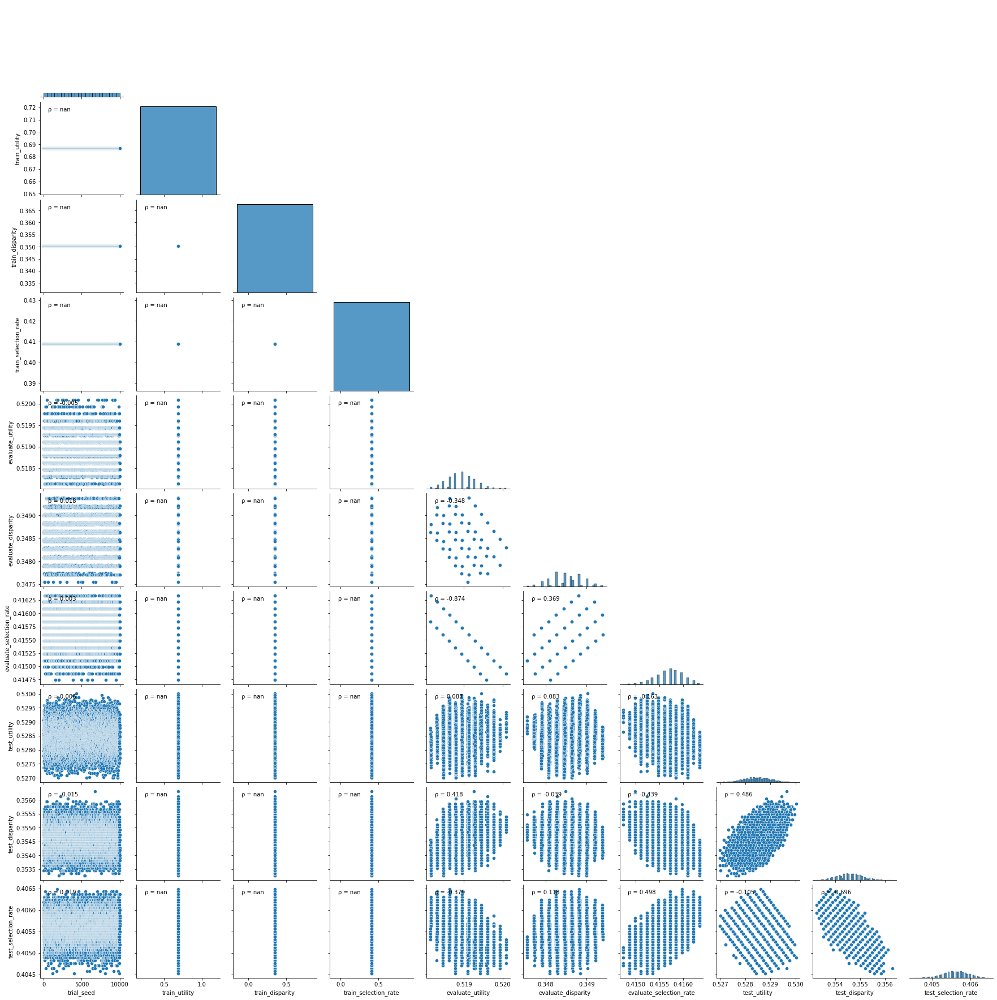

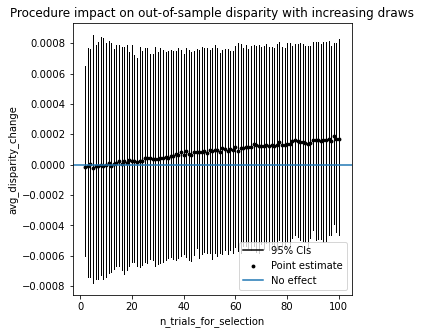

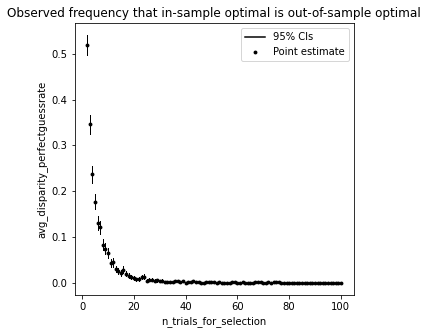

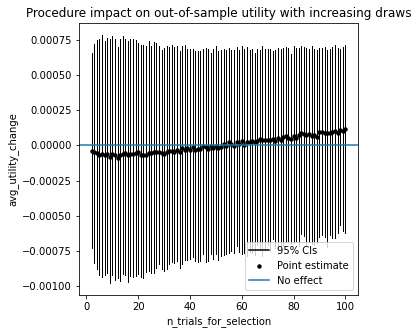

In [28]:
# Visualize
info_suffix='adultdtrandomseed'

visualize_pairplot(results_test,info_suffix=info_suffix)

visualize_disputil(analysis_df_test,info_suffix=info_suffix)


## Random Seed RF

In [29]:
# Results
results_test = get_results_lr(X_train,
                   X_train_male,
                   X_train_female,
                   y_train,
                   y_train_male,
                   y_train_female,
                   X_evaluate,
                   X_evaluate_male,
                   X_evaluate_female,
                   y_evaluate,
                   y_evaluate_male,
                   y_evaluate_female,
                   X_test,
                   X_test_male,
                   X_test_female,
                   y_test,
                   y_test_male,
                   y_test_female,
                   ml_model = 'RF'
                   , search_procedure = 'randomseed'
                   , data = 'adult'
                   , lam = 1
                   , n_seeds = 10000
                   , n_rows_max = 50000
                   , filename = 'result_data/result_df.csv'
                             )

analysis_df_test = get_analysis(results_test
                ,n_trials_min = 2
                ,n_trials_max = 100
                ,m_samples_per_n_trial=2000
                ,m_samples_for_perfectguess_bootstrap=250
                ,n_rows_max = 50000
                ,filename='result_data/analysis_df.csv')


seed  0
seed  100
seed  200
seed  300
seed  400
seed  500
seed  600
seed  700
seed  800
seed  900
seed  1000
seed  1100
seed  1200
seed  1300
seed  1400
seed  1500
seed  1600
seed  1700
seed  1800
seed  1900
seed  2000
seed  2100
seed  2200
seed  2300
seed  2400
seed  2500
seed  2600
seed  2700
seed  2800
seed  2900
seed  3000
seed  3100
seed  3200
seed  3300
seed  3400
seed  3500
seed  3600
seed  3700
seed  3800
seed  3900
seed  4000
seed  4100
seed  4200
seed  4300
seed  4400
seed  4500
seed  4600
seed  4700
seed  4800
seed  4900
seed  5000
seed  5100
seed  5200
seed  5300
seed  5400
seed  5500
seed  5600
seed  5700
seed  5800
seed  5900
seed  6000
seed  6100
seed  6200
seed  6300
seed  6400
seed  6500
seed  6600
seed  6700
seed  6800
seed  6900
seed  7000
seed  7100
seed  7200
seed  7300
seed  7400
seed  7500
seed  7600
seed  7700
seed  7800
seed  7900
seed  8000
seed  8100
seed  8200
seed  8300
seed  8400
seed  8500
seed  8600
seed  8700
seed  8800
seed  8900
seed  9000
seed  9100


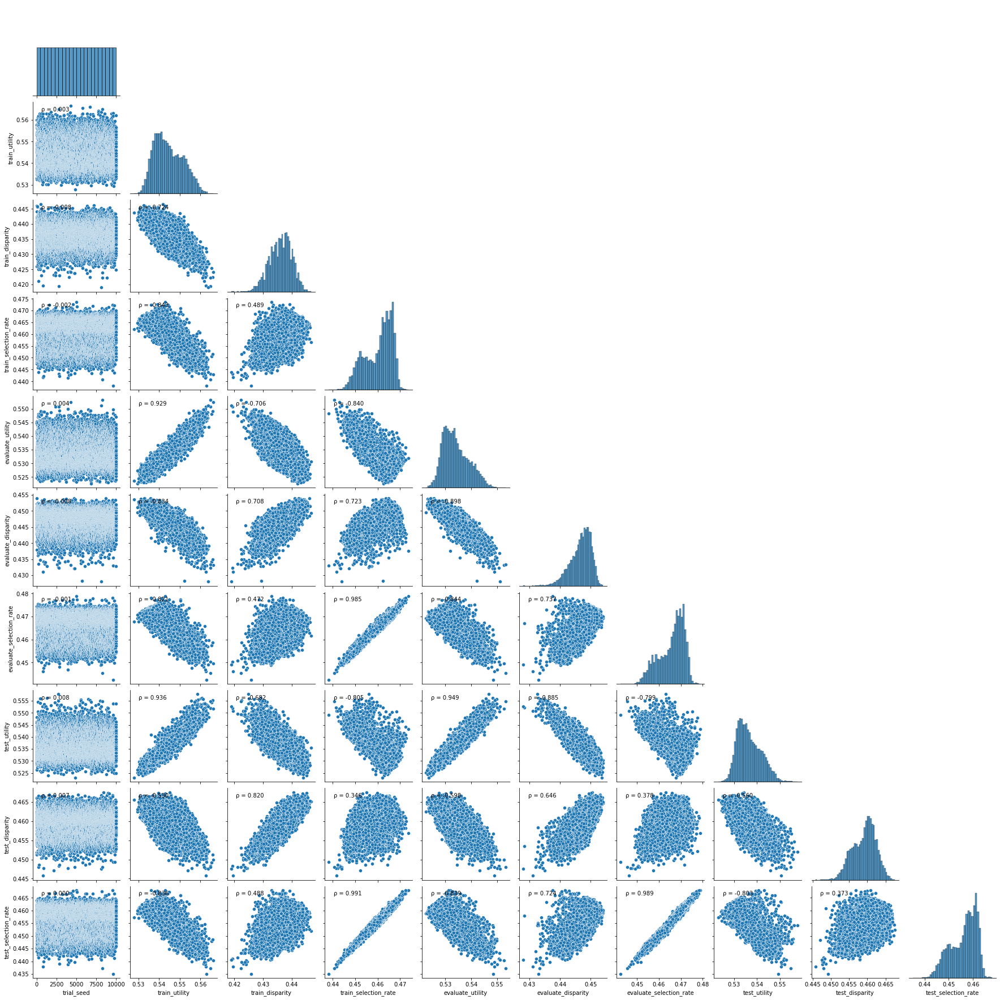

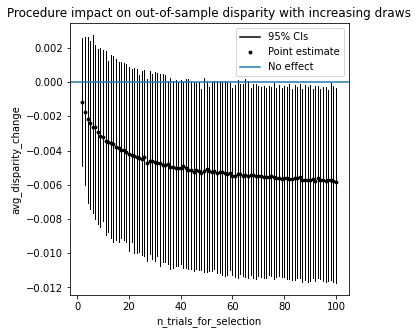

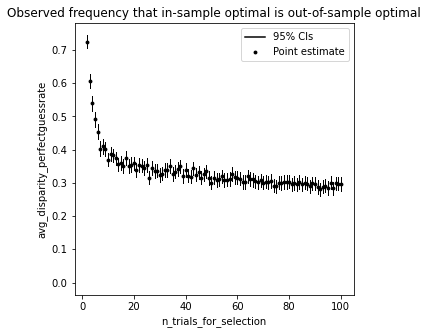

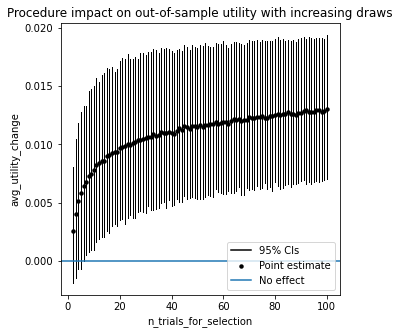

In [30]:
# Visualize
info_suffix='adultrfrandomseed'

visualize_pairplot(results_test,info_suffix=info_suffix)

visualize_disputil(analysis_df_test,info_suffix=info_suffix)


# GERMAN CREDIT WITH FEWER ATTRIBUTES

In [6]:
# Data wrangling

attribute_list=[
    'checking_account_category'
    ,'duration_in_month'
    ,'credit_history_category'
    ,'purpose_category'
    ,'credit_amount'
    ,'savings_account_category'
    ,'unemployment_category'
    ,'installment_rate_percentage_income'
    ,'sex_and_marriage_status_category'
    ,'other_debtors_guarantors_category'
    ,'present_residence_duration'
    ,'property_category'
    ,'age'
    ,'installment_plans_category'
    ,'housing_category'
    ,'number_existing_credits_at_bank'
    ,'job_category'
    ,'number_of_people_liable_maintenance'
    ,'telephone_category'
    ,'foreign_category'
    ,'y'
]
german = pd.read_csv('~/Python Projects/LDA_empirics/statlog+german+credit+data 2/german.data'
                     ,names=attribute_list
                     ,index_col=False
                     ,delimiter=' '
                     #,header=0
                    )
german['y']=german['y']-1
german['sex_category']=np.logical_not(np.logical_or(np.equal(german['sex_and_marriage_status_category'],'A92'), np.equal(german['sex_and_marriage_status_category'],'A95')))
german['single_category']=np.logical_or(np.equal(german['sex_and_marriage_status_category'],'A93'), np.equal(german['sex_and_marriage_status_category'],'A95'))

y_withsex,X_withsex = patsy.dmatrices('y ~ sex_category + checking_account_category + duration_in_month + credit_history_category + purpose_category + credit_amount + savings_account_category + unemployment_category + installment_rate_percentage_income + other_debtors_guarantors_category + present_residence_duration + property_category + age + installment_plans_category + housing_category + number_existing_credits_at_bank + job_category + number_of_people_liable_maintenance + telephone_category + foreign_category + single_category',data=german)
y,X = patsy.dmatrices('y ~ checking_account_category + duration_in_month + credit_history_category + purpose_category + credit_amount + savings_account_category + unemployment_category + installment_rate_percentage_income + other_debtors_guarantors_category + present_residence_duration + property_category + age + installment_plans_category + housing_category + number_existing_credits_at_bank + job_category + number_of_people_liable_maintenance + telephone_category + foreign_category + single_category',data=german)

y_withsex,X_withsex = patsy.dmatrices('y ~ sex_category + credit_history_category + credit_amount + unemployment_category + installment_rate_percentage_income + present_residence_duration',data=german)
y,X = patsy.dmatrices('y ~ credit_history_category + credit_amount + unemployment_category + installment_rate_percentage_income + present_residence_duration',data=german)

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = .3,random_state=1)
X_train_s, X_test_s, y_train_s, y_test_s = train_test_split(X_withsex, y_withsex, test_size = .3,random_state=1)

X_train, X_evaluate, y_train, y_evaluate = train_test_split(X_train, y_train, test_size = .4,random_state=1)
X_train_s, X_evaluate_s, y_train_s, y_evaluate_s = train_test_split(X_train_s, y_train_s, test_size = .4,random_state=1)

#Which index is the sex variable?
s_index = 1

X_test_male = X_test[X_test_s[:,s_index]==1]
y_test_male = y_test[X_test_s[:,s_index]==1]
X_test_female = X_test[X_test_s[:,s_index]==0]
y_test_female = y_test[X_test_s[:,s_index]==0]

X_train_male = X_train[X_train_s[:,s_index]==1]
y_train_male = y_train[X_train_s[:,s_index]==1]
X_train_female = X_train[X_train_s[:,s_index]==0]
y_train_female = y_train[X_train_s[:,s_index]==0]

X_evaluate_male = X_evaluate[X_evaluate_s[:,s_index]==1]
y_evaluate_male = y_evaluate[X_evaluate_s[:,s_index]==1]
X_evaluate_female = X_evaluate[X_evaluate_s[:,s_index]==0]
y_evaluate_female = y_evaluate[X_evaluate_s[:,s_index]==0]


## Sample LR

In [7]:
# Results
results_test = get_results_lr(X_train,
                   X_train_male,
                   X_train_female,
                   y_train,
                   y_train_male,
                   y_train_female,
                   X_evaluate,
                   X_evaluate_male,
                   X_evaluate_female,
                   y_evaluate,
                   y_evaluate_male,
                   y_evaluate_female,
                   X_test,
                   X_test_male,
                   X_test_female,
                   y_test,
                   y_test_male,
                   y_test_female,
                   ml_model = 'LR'
                   , search_procedure = 'sample'
                   , data = 'germancreditlessfeatures'
                   , lam = 1
                   , n_seeds = 10000
                   , n_rows_max = 50000
                   , filename = 'result_data/result_df.csv'
                             )

analysis_df_test = get_analysis(results_test
                ,n_trials_min = 2
                ,n_trials_max = 100
                ,m_samples_per_n_trial=2000
                ,m_samples_for_perfectguess_bootstrap=250
                ,n_rows_max = 50000
                ,filename='result_data/analysis_df.csv')

seed  0
seed  100
seed  200
seed  300
seed  400
seed  500
seed  600
seed  700
seed  800
seed  900
seed  1000
seed  1100
seed  1200
seed  1300
seed  1400
seed  1500
seed  1600
seed  1700
seed  1800
seed  1900
seed  2000
seed  2100
seed  2200
seed  2300
seed  2400
seed  2500
seed  2600
seed  2700
seed  2800
seed  2900
seed  3000
seed  3100
seed  3200
seed  3300
seed  3400
seed  3500
seed  3600
seed  3700
seed  3800
seed  3900
seed  4000
seed  4100
seed  4200
seed  4300
seed  4400
seed  4500
seed  4600
seed  4700
seed  4800
seed  4900
seed  5000
seed  5100
seed  5200
seed  5300
seed  5400
seed  5500
seed  5600
seed  5700
seed  5800
seed  5900
seed  6000
seed  6100
seed  6200
seed  6300
seed  6400
seed  6500
seed  6600
seed  6700
seed  6800
seed  6900
seed  7000
seed  7100
seed  7200
seed  7300
seed  7400
seed  7500
seed  7600
seed  7700
seed  7800
seed  7900
seed  8000
seed  8100
seed  8200
seed  8300
seed  8400
seed  8500
seed  8600
seed  8700
seed  8800
seed  8900
seed  9000
seed  9100


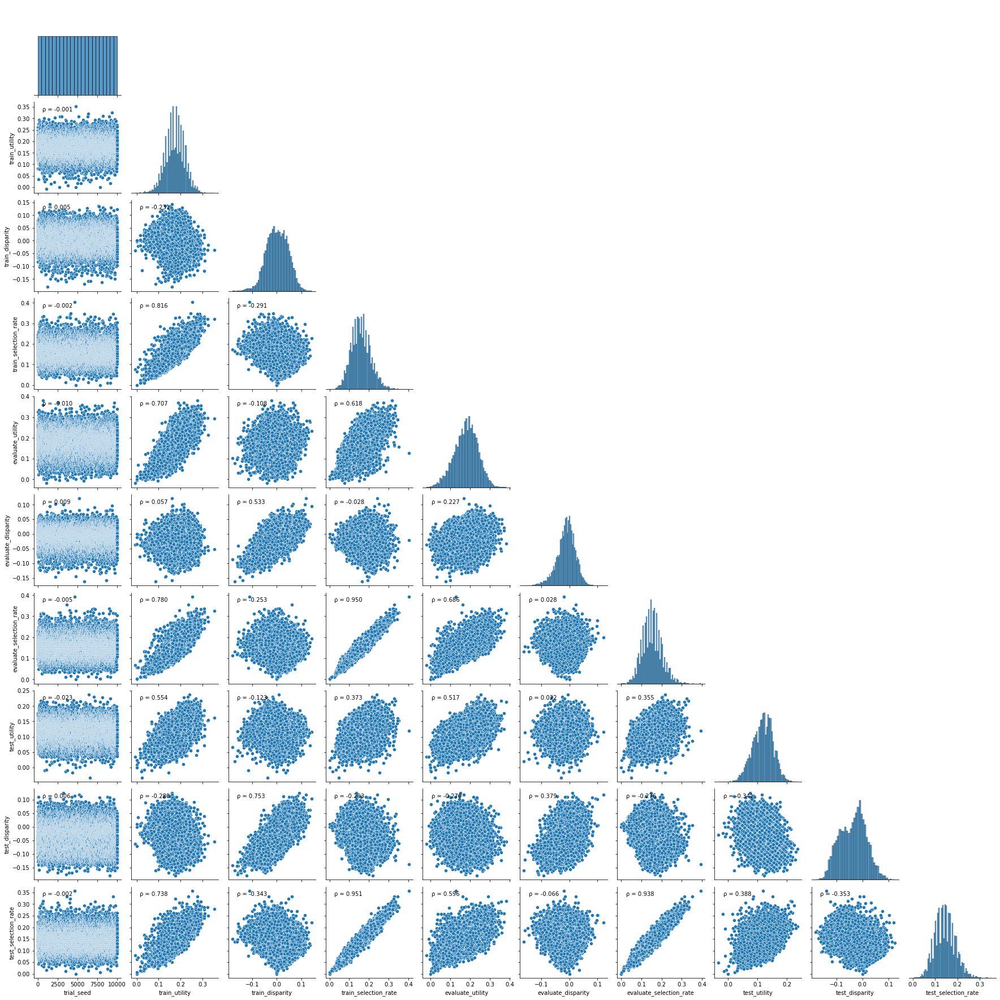

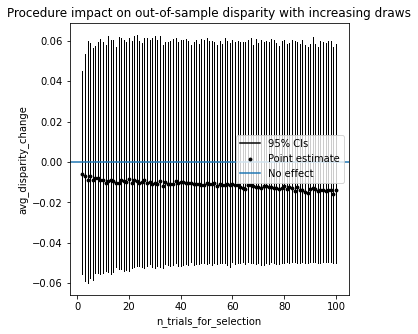

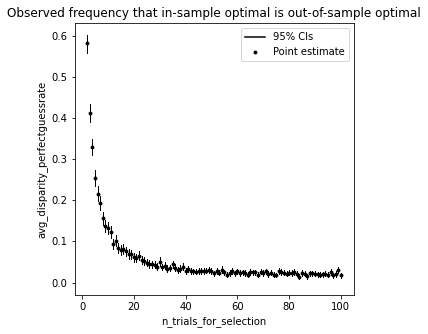

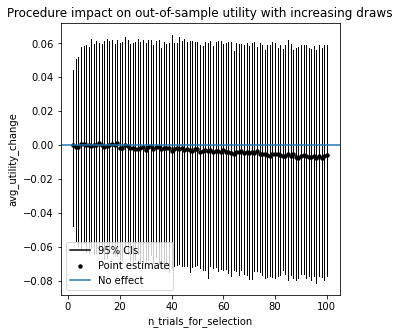

In [8]:
# Visualize
info_suffix='germancreditlessfeatureslrsample'

visualize_pairplot(results_test,info_suffix=info_suffix)

visualize_disputil(analysis_df_test,info_suffix=info_suffix)


## Sample DT

In [9]:
# Results
results_test = get_results_lr(X_train,
                   X_train_male,
                   X_train_female,
                   y_train,
                   y_train_male,
                   y_train_female,
                   X_evaluate,
                   X_evaluate_male,
                   X_evaluate_female,
                   y_evaluate,
                   y_evaluate_male,
                   y_evaluate_female,
                   X_test,
                   X_test_male,
                   X_test_female,
                   y_test,
                   y_test_male,
                   y_test_female,
                   ml_model = 'DT'
                   , search_procedure = 'sample'
                   , data = 'germancreditlessfeatures'
                   , lam = 1
                   , n_seeds = 10000
                   , n_rows_max = 50000
                   , filename = 'result_data/result_df.csv'
                             )

analysis_df_test = get_analysis(results_test
                ,n_trials_min = 2
                ,n_trials_max = 100
                ,m_samples_per_n_trial=2000
                ,m_samples_for_perfectguess_bootstrap=250
                ,n_rows_max = 50000
                ,filename='result_data/analysis_df.csv')


seed  0
seed  100
seed  200
seed  300
seed  400
seed  500
seed  600
seed  700
seed  800
seed  900
seed  1000
seed  1100
seed  1200
seed  1300
seed  1400
seed  1500
seed  1600
seed  1700
seed  1800
seed  1900
seed  2000
seed  2100
seed  2200
seed  2300
seed  2400
seed  2500
seed  2600
seed  2700
seed  2800
seed  2900
seed  3000
seed  3100
seed  3200
seed  3300
seed  3400
seed  3500
seed  3600
seed  3700
seed  3800
seed  3900
seed  4000
seed  4100
seed  4200
seed  4300
seed  4400
seed  4500
seed  4600
seed  4700
seed  4800
seed  4900
seed  5000
seed  5100
seed  5200
seed  5300
seed  5400
seed  5500
seed  5600
seed  5700
seed  5800
seed  5900
seed  6000
seed  6100
seed  6200
seed  6300
seed  6400
seed  6500
seed  6600
seed  6700
seed  6800
seed  6900
seed  7000
seed  7100
seed  7200
seed  7300
seed  7400
seed  7500
seed  7600
seed  7700
seed  7800
seed  7900
seed  8000
seed  8100
seed  8200
seed  8300
seed  8400
seed  8500
seed  8600
seed  8700
seed  8800
seed  8900
seed  9000
seed  9100


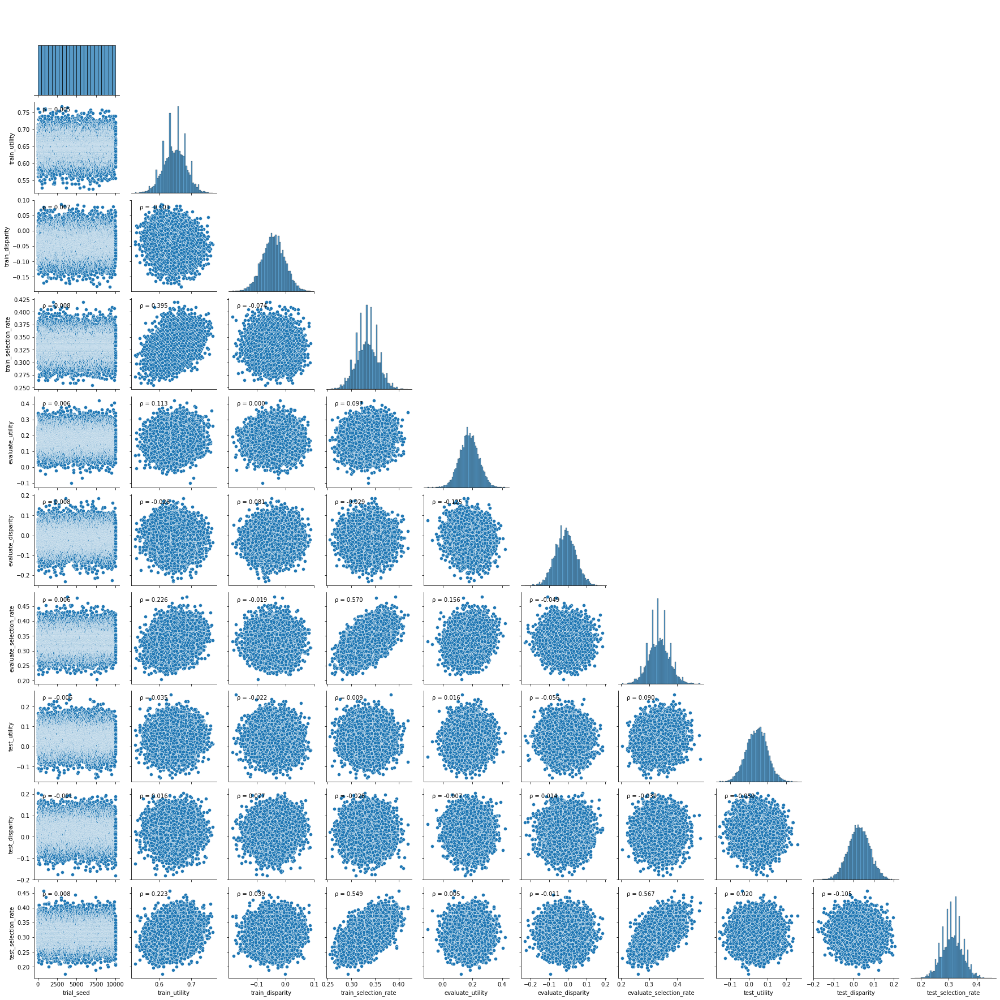

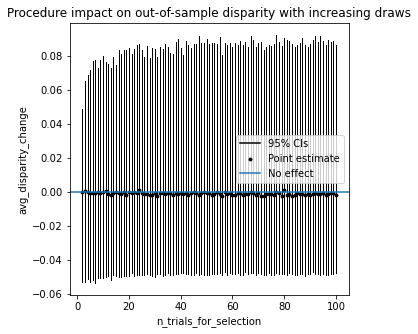

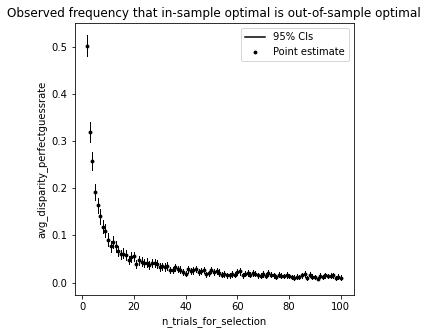

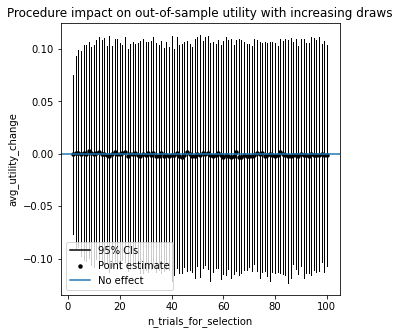

In [10]:
# Visualize
info_suffix='germancreditlessfeaturesdtsample'

visualize_pairplot(results_test,info_suffix=info_suffix)

visualize_disputil(analysis_df_test,info_suffix=info_suffix)


## Sample RF

In [11]:
# Results
results_test = get_results_lr(X_train,
                   X_train_male,
                   X_train_female,
                   y_train,
                   y_train_male,
                   y_train_female,
                   X_evaluate,
                   X_evaluate_male,
                   X_evaluate_female,
                   y_evaluate,
                   y_evaluate_male,
                   y_evaluate_female,
                   X_test,
                   X_test_male,
                   X_test_female,
                   y_test,
                   y_test_male,
                   y_test_female,
                   ml_model = 'RF'
                   , search_procedure = 'sample'
                   , data = 'germancreditlessfeatures'
                   , lam = 1
                   , n_seeds = 10000
                   , n_rows_max = 50000
                   , filename = 'result_data/result_df.csv'
                             )

analysis_df_test = get_analysis(results_test
                ,n_trials_min = 2
                ,n_trials_max = 100
                ,m_samples_per_n_trial=2000
                ,m_samples_for_perfectguess_bootstrap=250
                ,n_rows_max = 50000
                ,filename='result_data/analysis_df.csv')


seed  0
seed  100
seed  200
seed  300
seed  400
seed  500
seed  600
seed  700
seed  800
seed  900
seed  1000
seed  1100
seed  1200
seed  1300
seed  1400
seed  1500
seed  1600
seed  1700
seed  1800
seed  1900
seed  2000
seed  2100
seed  2200
seed  2300
seed  2400
seed  2500
seed  2600
seed  2700
seed  2800
seed  2900
seed  3000
seed  3100
seed  3200
seed  3300
seed  3400
seed  3500
seed  3600
seed  3700
seed  3800
seed  3900
seed  4000
seed  4100
seed  4200
seed  4300
seed  4400
seed  4500
seed  4600
seed  4700
seed  4800
seed  4900
seed  5000
seed  5100
seed  5200
seed  5300
seed  5400
seed  5500
seed  5600
seed  5700
seed  5800
seed  5900
seed  6000
seed  6100
seed  6200
seed  6300
seed  6400
seed  6500
seed  6600
seed  6700
seed  6800
seed  6900
seed  7000
seed  7100
seed  7200
seed  7300
seed  7400
seed  7500
seed  7600
seed  7700
seed  7800
seed  7900
seed  8000
seed  8100
seed  8200
seed  8300
seed  8400
seed  8500
seed  8600
seed  8700
seed  8800
seed  8900
seed  9000
seed  9100


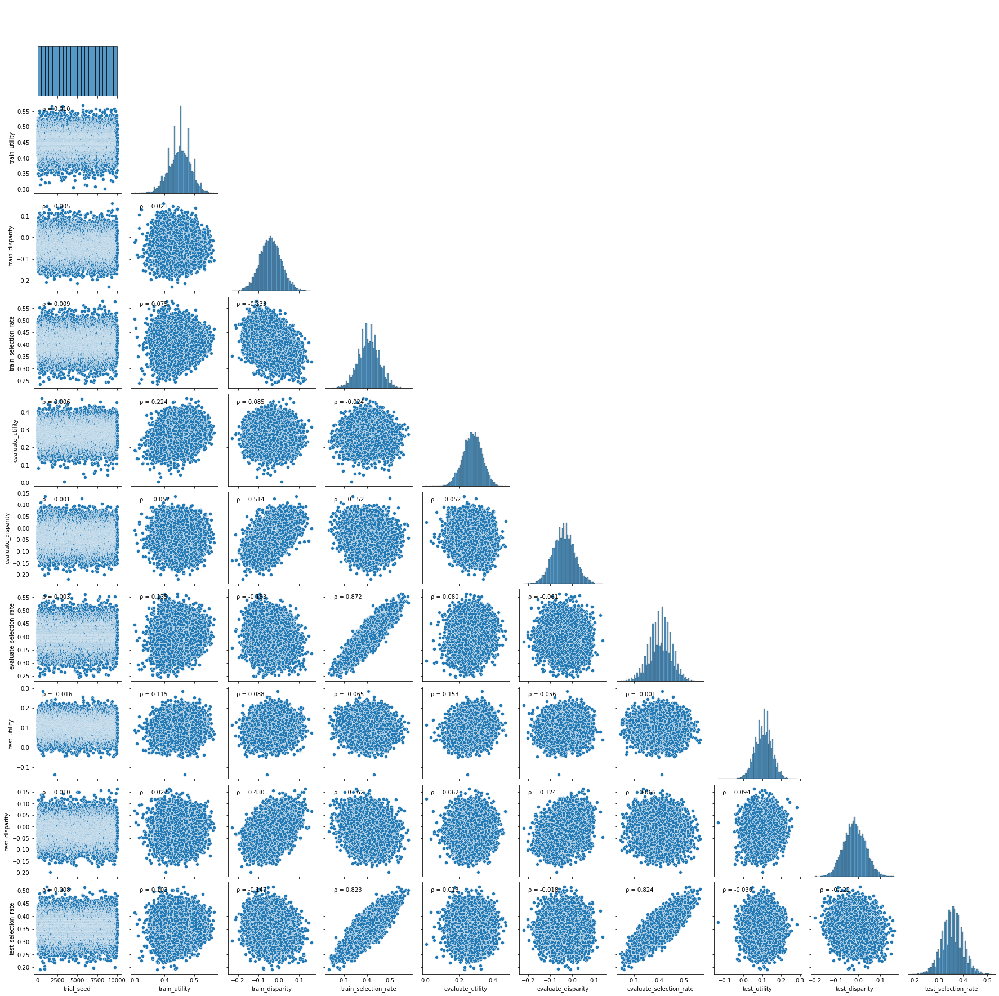

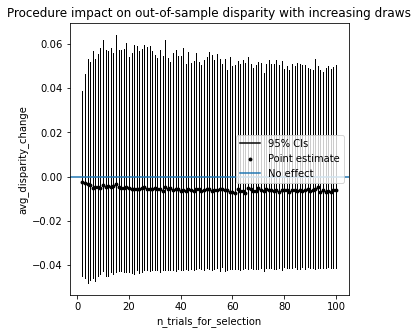

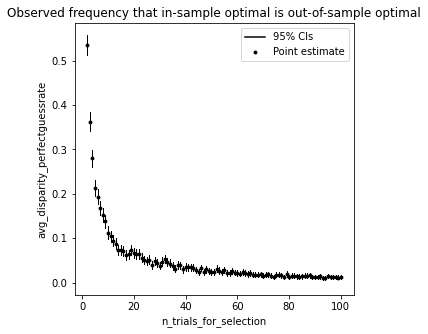

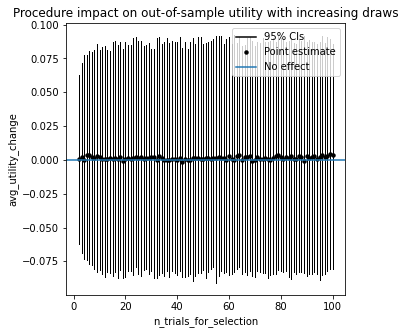

In [12]:
# Visualize
info_suffix='germancreditlessfeaturesrfsample'

visualize_pairplot(results_test,info_suffix=info_suffix)

visualize_disputil(analysis_df_test,info_suffix=info_suffix)


## Random Seed DT

In [13]:
# Results
results_test = get_results_lr(X_train,
                   X_train_male,
                   X_train_female,
                   y_train,
                   y_train_male,
                   y_train_female,
                   X_evaluate,
                   X_evaluate_male,
                   X_evaluate_female,
                   y_evaluate,
                   y_evaluate_male,
                   y_evaluate_female,
                   X_test,
                   X_test_male,
                   X_test_female,
                   y_test,
                   y_test_male,
                   y_test_female,
                   ml_model = 'DT'
                   , search_procedure = 'randomseed'
                   , data = 'germancreditlessfeatures'
                   , lam = 1
                   , n_seeds = 10000
                   , n_rows_max = 50000
                   , filename = 'result_data/result_df.csv'
                             )

analysis_df_test = get_analysis(results_test
                ,n_trials_min = 2
                ,n_trials_max = 100
                ,m_samples_per_n_trial=2000
                ,m_samples_for_perfectguess_bootstrap=250
                ,n_rows_max = 50000
                ,filename='result_data/analysis_df.csv')


seed  0
seed  100
seed  200
seed  300
seed  400
seed  500
seed  600
seed  700
seed  800
seed  900
seed  1000
seed  1100
seed  1200
seed  1300
seed  1400
seed  1500
seed  1600
seed  1700
seed  1800
seed  1900
seed  2000
seed  2100
seed  2200
seed  2300
seed  2400
seed  2500
seed  2600
seed  2700
seed  2800
seed  2900
seed  3000
seed  3100
seed  3200
seed  3300
seed  3400
seed  3500
seed  3600
seed  3700
seed  3800
seed  3900
seed  4000
seed  4100
seed  4200
seed  4300
seed  4400
seed  4500
seed  4600
seed  4700
seed  4800
seed  4900
seed  5000
seed  5100
seed  5200
seed  5300
seed  5400
seed  5500
seed  5600
seed  5700
seed  5800
seed  5900
seed  6000
seed  6100
seed  6200
seed  6300
seed  6400
seed  6500
seed  6600
seed  6700
seed  6800
seed  6900
seed  7000
seed  7100
seed  7200
seed  7300
seed  7400
seed  7500
seed  7600
seed  7700
seed  7800
seed  7900
seed  8000
seed  8100
seed  8200
seed  8300
seed  8400
seed  8500
seed  8600
seed  8700
seed  8800
seed  8900
seed  9000
seed  9100


/opt/homebrew/anaconda3/lib/python3.9/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/opt/homebrew/anaconda3/lib/python3.9/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/opt/homebrew/anaconda3/lib/python3.9/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/opt/homebrew/anaconda3/lib/python3.9/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/opt/homebrew/anaconda3/lib/python3.9/site-packages/scipy/stats/_stats_py.py:4781: ConstantInput

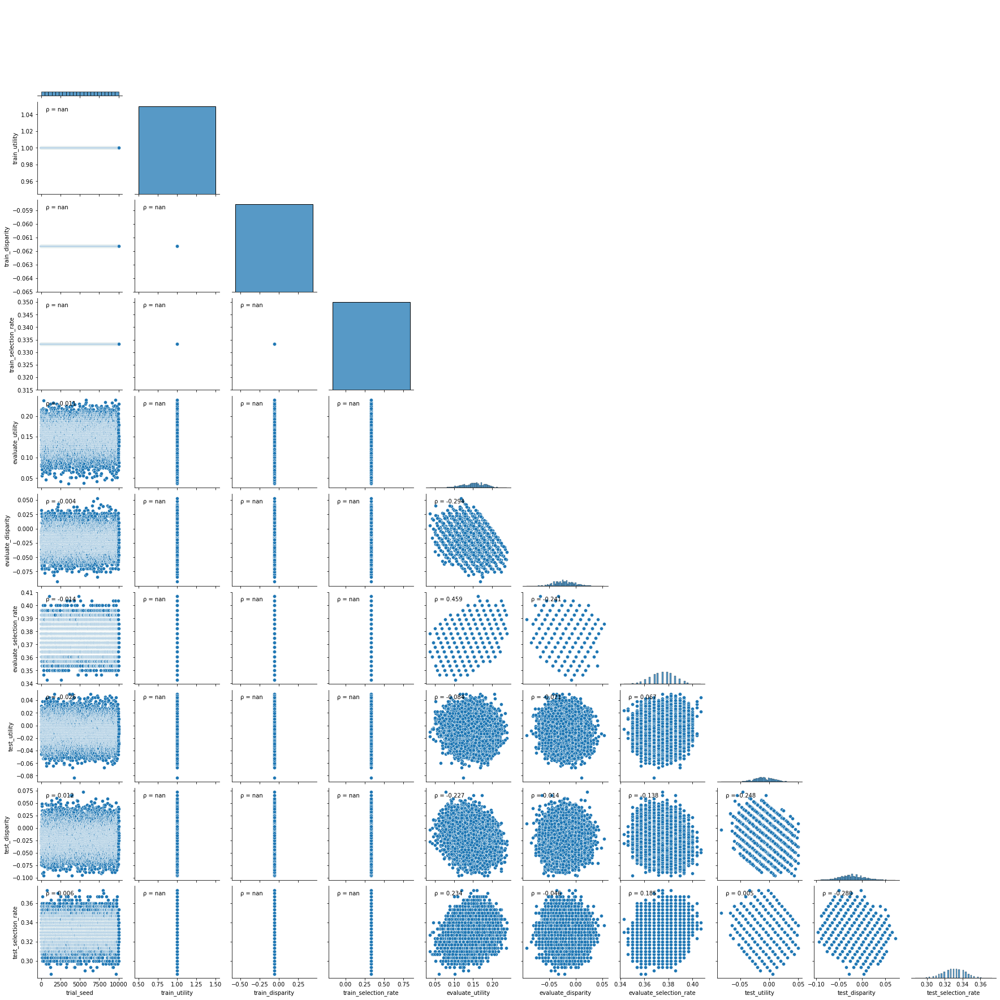

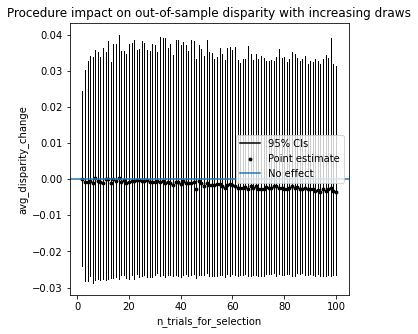

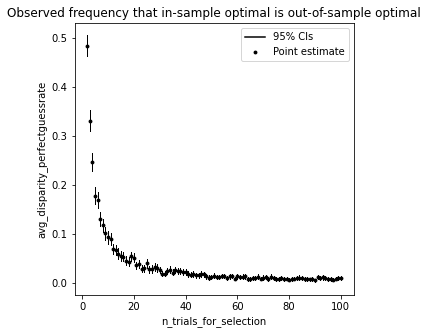

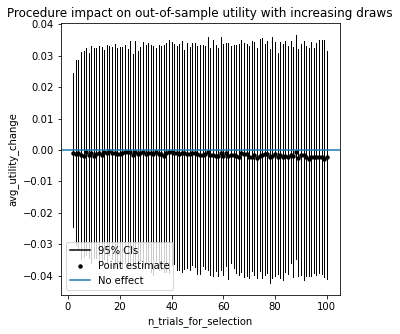

In [14]:
# Visualize
info_suffix='germancreditlessfeaturesdtrandomseed'

visualize_pairplot(results_test,info_suffix=info_suffix)

visualize_disputil(analysis_df_test,info_suffix=info_suffix)

## Random Seed RF

In [15]:
# Results
results_test = get_results_lr(X_train,
                   X_train_male,
                   X_train_female,
                   y_train,
                   y_train_male,
                   y_train_female,
                   X_evaluate,
                   X_evaluate_male,
                   X_evaluate_female,
                   y_evaluate,
                   y_evaluate_male,
                   y_evaluate_female,
                   X_test,
                   X_test_male,
                   X_test_female,
                   y_test,
                   y_test_male,
                   y_test_female,
                   ml_model = 'RF'
                   , search_procedure = 'randomseed'
                   , data = 'germancreditlessfeatures'
                   , lam = 1
                   , n_seeds = 10000
                   , n_rows_max = 50000
                   , filename = 'result_data/result_df.csv'
                             )

analysis_df_test = get_analysis(results_test
                ,n_trials_min = 2
                ,n_trials_max = 100
                ,m_samples_per_n_trial=2000
                ,m_samples_for_perfectguess_bootstrap=250
                ,n_rows_max = 50000
                ,filename='result_data/analysis_df.csv')


seed  0
seed  100
seed  200
seed  300
seed  400
seed  500
seed  600
seed  700
seed  800
seed  900
seed  1000
seed  1100
seed  1200
seed  1300
seed  1400
seed  1500
seed  1600
seed  1700
seed  1800
seed  1900
seed  2000
seed  2100
seed  2200
seed  2300
seed  2400
seed  2500
seed  2600
seed  2700
seed  2800
seed  2900
seed  3000
seed  3100
seed  3200
seed  3300
seed  3400
seed  3500
seed  3600
seed  3700
seed  3800
seed  3900
seed  4000
seed  4100
seed  4200
seed  4300
seed  4400
seed  4500
seed  4600
seed  4700
seed  4800
seed  4900
seed  5000
seed  5100
seed  5200
seed  5300
seed  5400
seed  5500
seed  5600
seed  5700
seed  5800
seed  5900
seed  6000
seed  6100
seed  6200
seed  6300
seed  6400
seed  6500
seed  6600
seed  6700
seed  6800
seed  6900
seed  7000
seed  7100
seed  7200
seed  7300
seed  7400
seed  7500
seed  7600
seed  7700
seed  7800
seed  7900
seed  8000
seed  8100
seed  8200
seed  8300
seed  8400
seed  8500
seed  8600
seed  8700
seed  8800
seed  8900
seed  9000
seed  9100


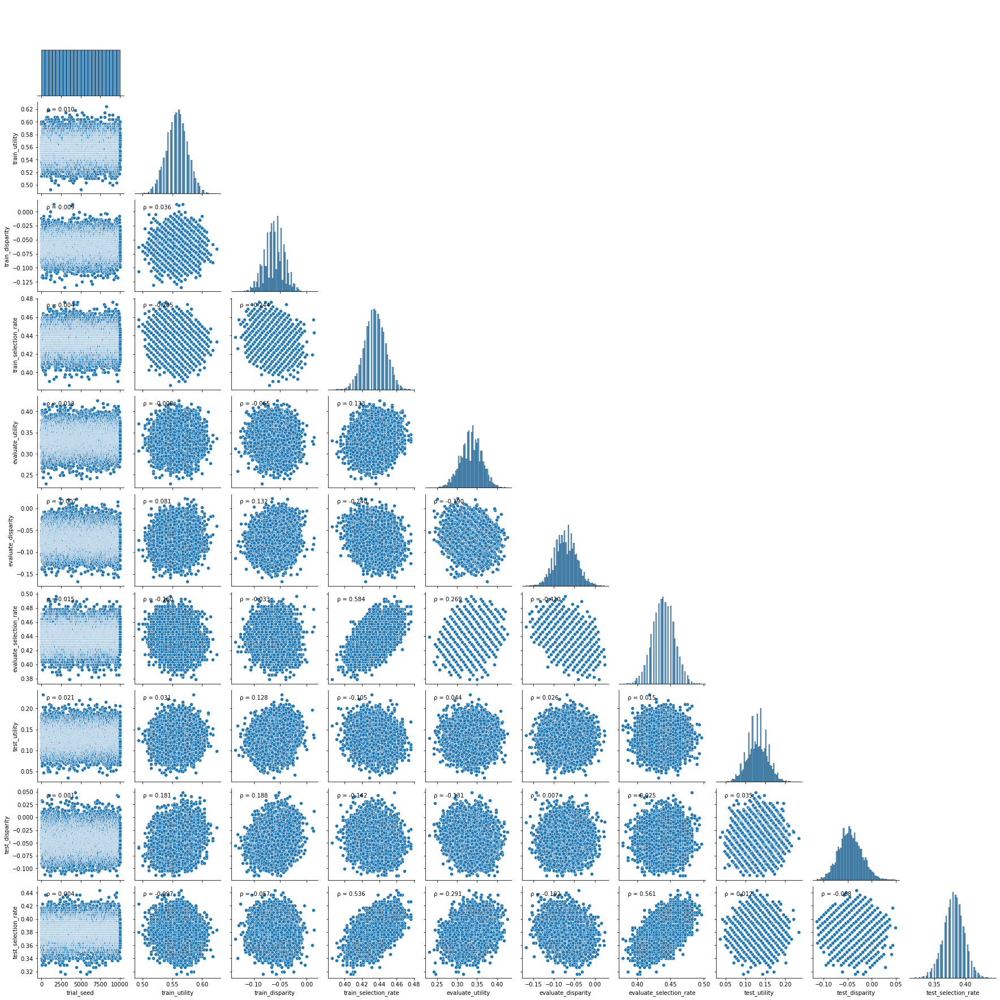

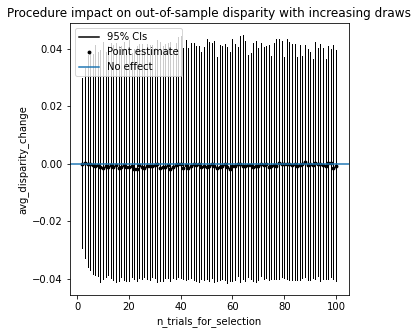

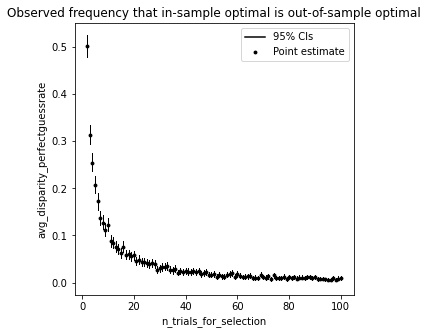

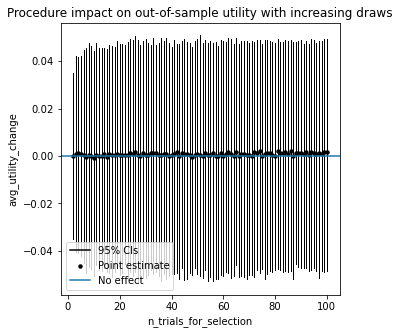

In [16]:
# Visualize
info_suffix='germancreditlessfeaturesrfrandomseed'

visualize_pairplot(results_test,info_suffix=info_suffix)

visualize_disputil(analysis_df_test,info_suffix=info_suffix)